# imports stuff!

In [1]:
!pip install -q pytorch-lightning

     |████████████████████████████████| 706 kB 4.3 MB/s 
     |████████████████████████████████| 5.9 MB 66.3 MB/s 
     |████████████████████████████████| 419 kB 64.2 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.


In [2]:
import os
from glob import glob
from pathlib import Path
import datetime
import random
import math

import matplotlib.pyplot as plt
from PIL import Image

import numpy as np
import skimage
import skimage.metrics

import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.transforms.functional import center_crop
from torchvision.utils import make_grid
from tqdm.auto import tqdm

import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint

In [3]:
# Set random seed for reproducibility
seed = 14383421    # with apologies to the funyarinpa
dataset_split_seed = 1797147     # with apologies to myself
print("Random Seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

Random Seed:  14383421


## Retrieve dataset from google drive

In [4]:
from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive')

Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive


In [5]:
%%bash

# copying stuff to the colab vm
echo "Making dirs"
mkdir realblur
echo "Decompressing archive"
tar -xf /content/drive/MyDrive/realblur.tar.gz -C realblur

Making dirs
Decompressing archive


# Dataset

Some data augmentations that will be used by the dataset

In [6]:
# essential not only for augmentation, but to enforce the correct size as well
# assumes both images are the same shape
def random_crop(img_pair, cropped_size):
    first, second = img_pair

    # -1 is only for irrational safety
    umax = first.shape[1] - cropped_size - 1
    vmax = first.shape[2] - cropped_size - 1

    u = random.randint(0, umax)
    v = random.randint(0, vmax)

    # random crop
    first = first[:, u:u+cropped_size, v:v+cropped_size]
    second = second[:, u:u+cropped_size, v:v+cropped_size]

    return first, second

And then proper data classes

In [7]:
class RealBlurDataset(Dataset):
  def __init__(self, target_size=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    self.target_size = target_size
    self.mean = mean
    self.std = std

    self._base_dir = "realblur/"
    train_file = self._base_dir + "RealBlur_J_Tele_test_list.txt"
    self._data_path = []
    with open(train_file, "r") as f:
      for line in f.readlines():
        s = line.split(" ")
        self._data_path.append([f"{self._base_dir}/{s[0]}", f"{self._base_dir}/{s[1]}"])
      f.close()

  def __getitem__(self, index):
    real = Image.open(self._data_path[index % len(self._data_path)][0])
    blurred = Image.open(self._data_path[index % len(self._data_path)][1])

    real = transforms.functional.to_tensor(real)
    blurred = transforms.functional.to_tensor(blurred)

    real = transforms.functional.normalize(real, self.mean, self.std)
    blurred = transforms.functional.normalize(blurred, self.mean, self.std)

    target_size = self.target_size
    if target_size:
      # crop for target size
      real, blurred = random_crop((real, blurred), target_size)


    return real, blurred

  def __len__(self):
    return len(self._data_path)

Also make a DataModule to handle train/test split *(so we can evaluate the metrics on a different set)*

In [8]:
class BSD_B_DataModule(pl.LightningDataModule):
    def __init__(
            self,
            batch_size,
            target_size=None,
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225],
            val_split=-1,       # *_split in [0,1]. Both express a part of the full dataset.
            test_split=-1,
            shuffle=True
    ):
        super().__init__()
        self.batch_size = batch_size
        self.target_size = target_size
        self.mean = mean
        self.std = std
        self.val_split = val_split
        self.test_split = test_split
        self.shuffle = shuffle
    
    def prepare_data(self):
        pass   # no download!
    
    def setup(self, stage=None):    # stage is unused here, load the whole dataset
        bsd_full = RealBlurDataset(target_size=target_size, mean=self.mean, std=self.std)

        if self.test_split > 0:
            test_samples = int(math.floor( len(bsd_full) * self.test_split ))
            bsd_trainval, self.bsd_test = torch.utils.data.random_split(bsd_full, [len(bsd_full) - test_samples, test_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            bsd_trainval, self.bsd_test = bsd_full, None
        
        if self.val_split > 0:
            val_samples = int(math.floor( len(bsd_full) * self.val_split ))   # both splits are expressed on the full dataset
            self.bsd_train, self.bds_val = torch.utils.data.random_split(bsd_trainval, [len(bsd_trainval) - val_samples, val_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            self.bsd_train, self.bsd_val = bsd_trainval, None
    
    def train_dataloader(self):
        return DataLoader(self.bsd_train, batch_size=self.batch_size, shuffle=self.shuffle)
    
    def val_dataloader(self):
        if self.bsd_val != None:
            return DataLoader(self.bsd_val, batch_size=self.batch_size)
        else:
            return []
    
    def test_dataloader(self):
        if self.bsd_test != None:
            return DataLoader(self.bsd_test, batch_size=self.batch_size)
        else:
            return []

# testing this cell...
# TODO remove
d = BSD_B_DataModule(32)

# Networks

## Generator

Traditional convolution (i.e. encoder) block, combines the actual conv layer and the things that need to be done right after each layer for ease of construction.
The default settings for kernel_size, stride, padding will halve the image's width/height at each layer.

In [9]:
class ConvBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=5, stride=2, padding=2, use_activation=True, use_batchnorm=True):
        super().__init__()
        self.use_activation = use_activation
        self.use_batchnorm = use_batchnorm

        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)

        if use_batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if use_activation:
            self.act = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.conv(x)
        if self.use_batchnorm:
            x = self.bn(x)
        if self.use_activation:
            x = self.act(x)
        return x

Transpose convolution (i.e. decoder) block, combines the actual t.conv layer and the things that need to be done right after each layer for ease of construction.
The default settings for kernel_size, stride, padding will double the image's width/height at each layer.

In [10]:
class ConvTranspBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, use_activation=True, use_batchnorm=True, use_dropout=False):
        super().__init__()
        self.use_activation = use_activation
        self.use_batchnorm = use_batchnorm
        self.use_dropout = use_dropout

        self.tconv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding)

        if use_batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if use_activation:
            self.act = nn.LeakyReLU(0.2)

        if use_dropout:
            self.drop = nn.Dropout2d(0.5)

    def forward(self, x):
        x = self.tconv(x)
        if self.use_batchnorm:
            x = self.bn(x)
        if self.use_activation:
            x = self.act(x)
        if self.use_dropout:
            x = self.drop(x)
        return x

In [11]:
class ResnetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=5):
        super().__init__()
        padding = kernel_size // 2
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding)

        self.bn1 = nn.BatchNorm2d(out_channels)
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, input):
        output = nn.ReLU()(self.bn1(self.conv1(input)))
        output = nn.ReLU()(self.bn2(self.conv2(output)))
        input = input + output
        return nn.ReLU()(input)

In [12]:
class ConvLSTMCell(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, padding, activation, frame_size):

        super(ConvLSTMCell, self).__init__()  

        if activation == "tanh":
            self.activation = torch.tanh 
        elif activation == "relu":
            self.activation = torch.relu
        
        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        self.conv = nn.Conv2d(
            in_channels=in_channels + out_channels, 
            out_channels=4 * out_channels, 
            kernel_size=kernel_size, 
            padding=padding)           

        # Initialize weights for Hadamard Products
        self.W_ci = nn.Parameter(torch.Tensor(out_channels, *frame_size))
        self.W_co = nn.Parameter(torch.Tensor(out_channels, *frame_size))
        self.W_cf = nn.Parameter(torch.Tensor(out_channels, *frame_size))

    def forward(self, X, H_prev, C_prev):

        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        conv_output = self.conv(torch.cat([X, H_prev], dim=1))

        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        i_conv, f_conv, C_conv, o_conv = torch.chunk(conv_output, chunks=4, dim=1)

        input_gate = torch.sigmoid(i_conv + self.W_ci * C_prev )
        forget_gate = torch.sigmoid(f_conv + self.W_cf * C_prev )

        # Current Cell output
        C = forget_gate*C_prev + input_gate * self.activation(C_conv)

        output_gate = torch.sigmoid(o_conv + self.W_co * C )

        # Current Hidden State
        H = output_gate * self.activation(C)

        return H, C

class ConvLSTM(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, padding, activation, frame_size):

        super(ConvLSTM, self).__init__()

        self.out_channels = out_channels

        # We will unroll this over time steps
        self.convLSTMcell = ConvLSTMCell(in_channels, out_channels, kernel_size, padding, activation, frame_size)

    def forward(self, X, state):

        # X is a frame sequence (batch_size, num_channels, seq_len, height, width)

        # Get the dimensions
        batch_size, _, height, width = X.size()

        # Initialize output
        output = torch.zeros(batch_size, self.out_channels, 1, height, width).cuda()
        
        if state is None:
            # Initialize Hidden State
            H = torch.zeros(batch_size, self.out_channels, height, width)
            # Initialize Cell Input
            C = torch.zeros(batch_size,self.out_channels, height, width)
        else:
            H, C = state
            H = transforms.Resize((height, width))(H)
            C = transforms.Resize((height, width))(C)
        
        H, C = H.cuda(), C.cuda()

        H, C = self.convLSTMcell(X, H, C)

        H, C = H.cuda(), C.cuda()

        return H, (H, C)

In [13]:
class Generator(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.scale = [.25, .5, 1]

         # create the layers of the "encoder" half of the generator
        blockListPreLSTM = [
            ConvBlock(in_channels*2, 32, stride=1, padding=1, use_batchnorm=False),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ConvBlock(32, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ConvBlock(64, 128, use_batchnorm=False),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128)
        ]
        lstm = lambda size: ConvLSTM(128, 128, 5, 2, "relu", size)
        blockListPostLSTM = [
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ConvTranspBlock(128, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ConvTranspBlock(64, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ConvBlock(32, out_channels, kernel_size=5, stride=1, padding=2, use_activation=False)
        ]

        self.preLstm1 = nn.ModuleList(blockListPreLSTM)
        self.lstm1 = lstm((16, 16))
        self.postLstm1 = nn.ModuleList(blockListPostLSTM)

        self.preLstm2 = nn.ModuleList(blockListPreLSTM)
        self.lstm2 = lstm((32, 32))
        self.postLstm2 = nn.ModuleList(blockListPostLSTM)

        self.preLstm3 = nn.ModuleList(blockListPreLSTM)
        self.lstm3 = lstm((64, 64))
        self.postLstm3 = nn.ModuleList(blockListPostLSTM)

        self.blocks = [
            [ self.preLstm1, self.lstm1, self.postLstm1 ],
            [ self.preLstm2, self.lstm2, self.postLstm2 ],
            [ self.preLstm3, self.lstm3, self.postLstm3 ]
        ]

        self.final_act = nn.Tanh()


    def forward(self, input):
        _, _, h, w = input.shape

        rnn_state = None

        inp_pred = input

        for i in range(len(self.scale)):
            scale = self.scale[i]
            hi = int(round(h * scale))
            wi = int(round(w * scale))

            # Original of the paper, concat of the two images
            inp_blur = transforms.Resize((hi, wi))(input)
            inp_pred = transforms.Resize((hi, wi))(inp_pred).detach()
            output = torch.cat([inp_blur, inp_pred], dim=1)
            # Simpler version
            # output = transforms.Resize((hi, wi))(input)

            preLstm, lstm, postLstm = self.blocks[i]
            for pre in preLstm:
                output = pre(output)
            output, rnn_state = lstm(output, rnn_state)
            for post in postLstm:
                output = post(output)

        return self.final_act(output)

## Discriminator (PatchGAN)

In [14]:
class PatchGAN(nn.Module):

    def __init__(self, input_channels):
        super().__init__()
        self.conv1 = ConvBlock(input_channels, 64, use_batchnorm=False)
        self.conv2 = ConvBlock(64, 128)
        self.conv3 = ConvBlock(128, 256)
        self.conv4 = ConvBlock(256, 512)
        self.final = nn.Conv2d(512, 1, kernel_size=1)

    def forward(self, x, y):
        x = torch.cat([x, y], axis=1)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.final(x)
        return x

## Full GAN

*(some utils first)*

In [15]:
# https://stackoverflow.com/questions/49433936/how-to-initialize-weights-in-pytorch

# randomize initial weights by a normal distribution
def _weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# shows blurred input, real original image, and generator output side by side for qualitative comparison.
# also takes care of converting from torch tensor (potentially) in the GPU to visualizable images.
def show_images_sidebyside(cond, fake, real, denormalization, figsize=(10,5)):
    cond = denormalization(cond)
    fake = denormalization(fake)
    real = denormalization(real)

    cond = cond.detach().cpu().permute(1, 2, 0)
    fake = fake.detach().cpu().permute(1, 2, 0)
    real = real.detach().cpu().permute(1, 2, 0)
    
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    ax[0].imshow(cond)
    ax[2].imshow(fake)
    ax[1].imshow(real)
    plt.show()

# invert normalization to visualize.
# explained here: https://discuss.pytorch.org/t/simple-way-to-inverse-transform-normalization/4821/4
def denormalize(img, mean, std):
    mean_r, mean_g, mean_b = mean
    std_r, std_g, std_b = std
    return transforms.functional.normalize(
        img,
        [-mean_r/std_r, -mean_g/std_g, -mean_b/std_b],
        [      1/std_r,       1/std_g,       1/std_b]
    )

def denormalize_factory(the_mean, the_std):
    return lambda img: denormalize(img, the_mean, the_std)

Two losses: Adversarial l. to make realistic images in general, Reconstruction l. to produce an image near to the conditioning img.

In [16]:
class Pix2Pix(pl.LightningModule):

    def __init__(self, in_channels, out_channels, learning_rate=0.0002, lambda_recon=200, display_step=25, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):

        super().__init__()
        self.save_hyperparameters()     # This Lightning black magic saves all the parameters of __init__ without us telling it anything. Not sure how it's possible, but it is.
        
        self.display_step = display_step
        self.gen = Generator(in_channels, out_channels)
        self.discr = PatchGAN(in_channels + out_channels)

        # init weights
        self.gen = self.gen.apply(_weights_init)
        self.discr = self.discr.apply(_weights_init)

        # loss functions
        self.advers_criterion = nn.BCEWithLogitsLoss()
        self.recon_criterion = nn.L1Loss()

    def _gen_step(self, real_images, conditioning_images):
        # Generate!
        fake_images = self.gen(conditioning_images)

        # Calc adversarial loss...
        disc_logits = self.discr(fake_images, conditioning_images)
        adversarial_loss = self.advers_criterion(disc_logits, torch.ones_like(disc_logits))   # set groundtruth as "real" when training gen

        # ...then reconstruction loss...
        recon_loss = self.recon_criterion(fake_images, real_images)

        # ...finally combine with scale factor
        lambda_recon = self.hparams.lambda_recon
        return adversarial_loss + lambda_recon * recon_loss

    def _discr_step(self, real_images, conditioning_images):
        # Generate! (and don't do gradient)
        fake_images = self.gen(conditioning_images).detach()

        # Discriminate
        fake_logits = self.discr(fake_images, conditioning_images)
        real_logits = self.discr(real_images, conditioning_images)

        # Calc. classif. loss
        fake_loss = self.advers_criterion(fake_logits, torch.zeros_like(fake_logits))
        real_loss = self.advers_criterion(real_logits, torch.ones_like(real_logits))

        # as standard as expected
        return (real_loss + fake_loss) / 2

    def configure_optimizers(self):
        lr = self.hparams.learning_rate
        gen_opt = torch.optim.Adam(self.gen.parameters(), lr=lr)
        discr_opt = torch.optim.Adam(self.discr.parameters(), lr=lr)
        return discr_opt, gen_opt

    def training_step(self, batch, batch_idx, optimizer_idx):
        real, conditioning = batch

        # Step and log loss
        loss = None
        if optimizer_idx == 0:
            loss = self._discr_step(real, conditioning)
            self.log('PatchGAN Loss', loss)
        elif optimizer_idx == 1:
            loss = self._gen_step(real, conditioning)
            self.log('Generator Loss', loss)
        
        # show example images from time to time to qualitatively show some progress
        if self.current_epoch % self.display_step == 0 and batch_idx == 0 and optimizer_idx == 1:
            fake = self.gen(conditioning).detach()
            the_denormalize = denormalize_factory(self.hparams.mean, self.hparams.std)
            real0_for_psnr = the_denormalize(real[0]).cpu().numpy()
            fake0_for_psnr = the_denormalize(fake[0]).cpu().numpy()
            true_min, true_max = np.min(real0_for_psnr), np.max(real0_for_psnr)
            print("----", true_min, ",,", true_max)
            psnr = skimage.metrics.peak_signal_noise_ratio(
                real0_for_psnr,
                fake0_for_psnr
            )
            print("=====")
            print("This is epoch", self.current_epoch)
            print("And the PSNR is", psnr)
            print("And the images are...")
            show_images_sidebyside(conditioning[0], fake[0], real[0], lambda x:x)    # per ora voglio vedere sia normalizzate che denormalizzate
            show_images_sidebyside(conditioning[0], fake[0], real[0], the_denormalize)
        return loss

# Training!

## Parameters

In [17]:
# mean and standard deviation for normalization, calcuated manually over the dataset una-tantum.
# the code is in another notebook.
mean = [0.4355969288502789, 0.43763443105665034, 0.3649651865988699]
std = [0.23582929701856753, 0.2207150368759555, 0.23132070247996644]

lambda_recon = 200

n_epochs = 2000

display_step = 1
batch_size = 4
lr = 0.0002
target_size = 256

isodate = datetime.date.today().isoformat().replace("-", "")   # example: "20220624"
checkpoint_callback = ModelCheckpoint(
    save_top_k = -1, # i.e. save all, as per doc
    every_n_epochs = 4,
    save_on_train_epoch_end = True,
    dirpath = "/content/drive/MyDrive/VP/Checkpoints",
    filename = "ckpt-pix2pix-"+isodate+"-{epoch:02d}",
)

# some times...
# up to epoch 9 in 2h 50 min, w/ batch_size=4 and GPU

# Tensorboard

In [18]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

# Let's-a go

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:448: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  f"Setting `Trainer(gpus={gpus!r})` is deprecated in v1.7 and will be removed"
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:115: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/usr/local/lib/python3.7/dis

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/core/module.py:555: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  value = torch.tensor(value, device=self.device)


---- -2.811304e-08 ,, 1.0
=====
This is epoch 0
And the PSNR is 18.79837465152392
And the images are...


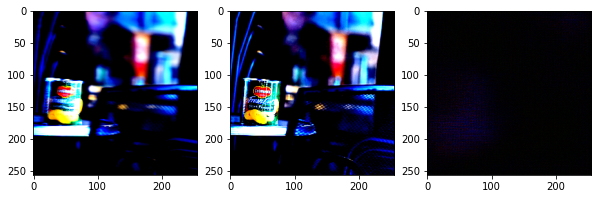

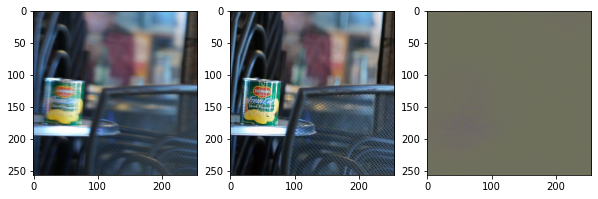

---- 0.0039215502 ,, 0.5921569
=====
This is epoch 1
And the PSNR is 12.276965937088672
And the images are...


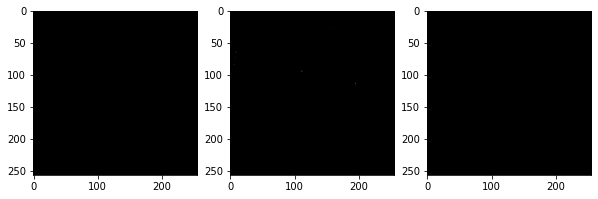

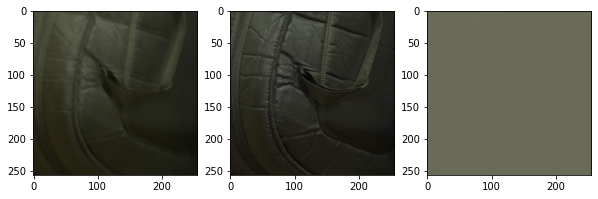

---- 0.003921565 ,, 0.9607842
=====
This is epoch 2
And the PSNR is 11.777533459137786
And the images are...


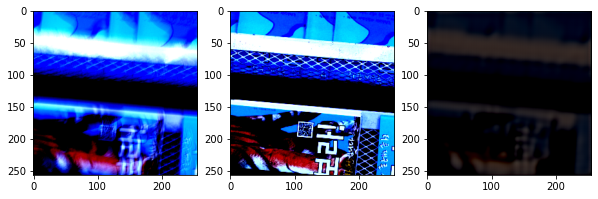

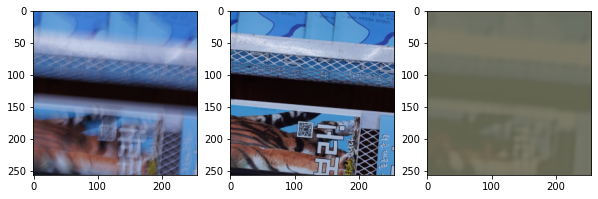

---- -2.811304e-08 ,, 1.0
=====
This is epoch 3
And the PSNR is 18.902187273169307
And the images are...


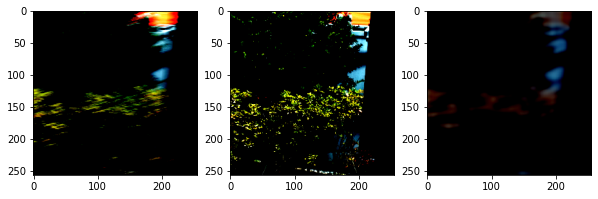

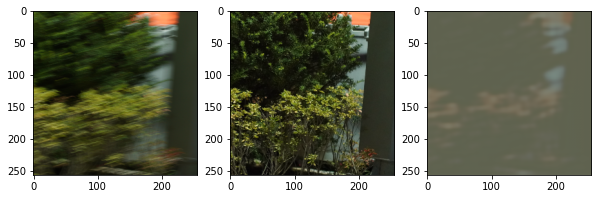

---- 0.0039215502 ,, 1.0
=====
This is epoch 4
And the PSNR is 15.15960697710932
And the images are...


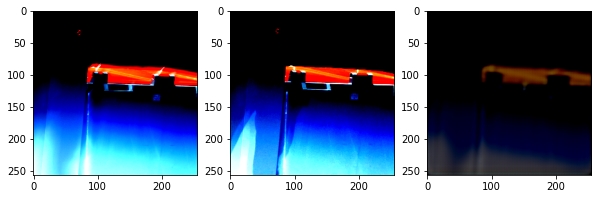

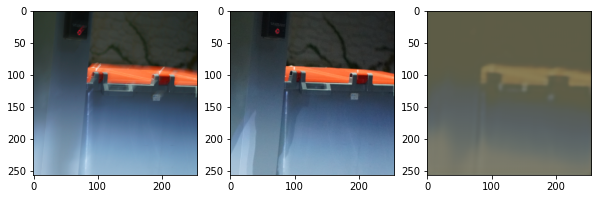

---- 0.031372525 ,, 0.72941184
=====
This is epoch 5
And the PSNR is 13.425551208516037
And the images are...


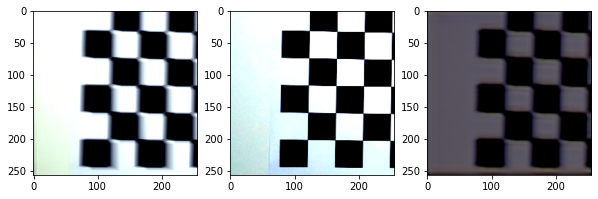

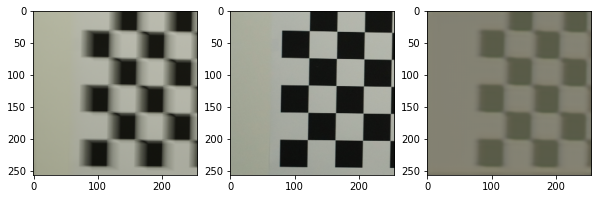

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 6
And the PSNR is 18.17513159269696
And the images are...


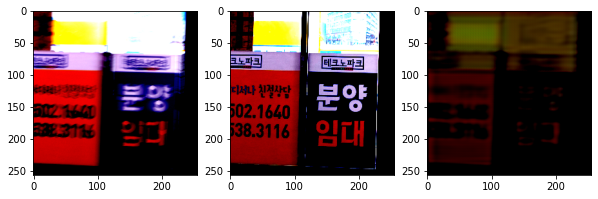

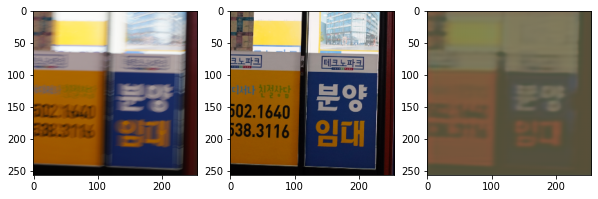

---- -2.811304e-08 ,, 1.0
=====
This is epoch 7
And the PSNR is 18.540378885658686
And the images are...


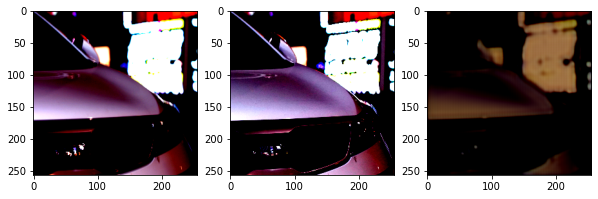

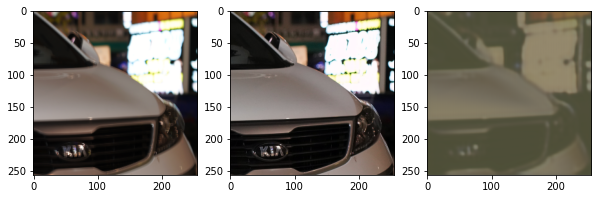

---- 0.074509785 ,, 0.89411765
=====
This is epoch 8
And the PSNR is 17.525923681821382
And the images are...


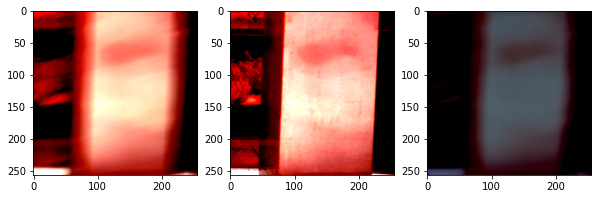

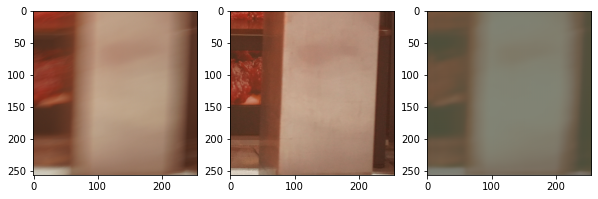

---- -2.811304e-08 ,, 0.7333333
=====
This is epoch 9
And the PSNR is 23.32828594764915
And the images are...


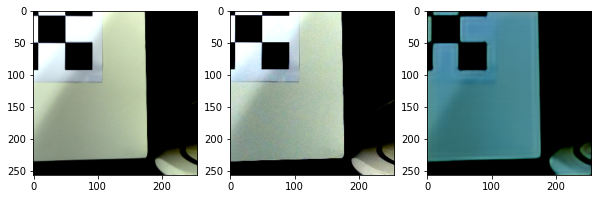

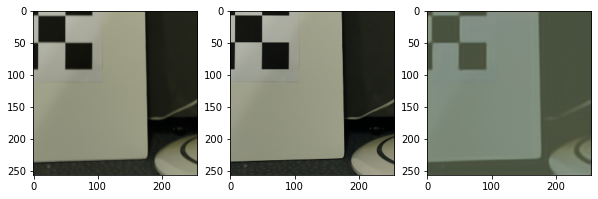

---- -2.811304e-08 ,, 0.9568627
=====
This is epoch 10
And the PSNR is 24.286017308054824
And the images are...


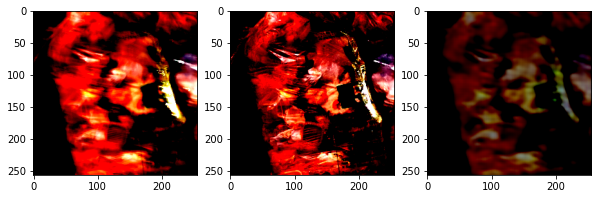

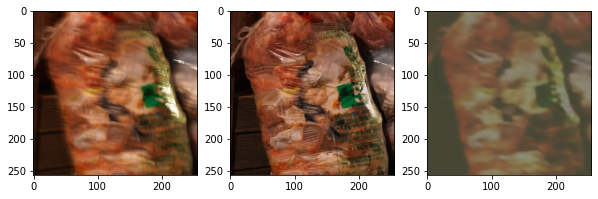

---- 0.02352941 ,, 0.97254896
=====
This is epoch 11
And the PSNR is 15.993953258190476
And the images are...


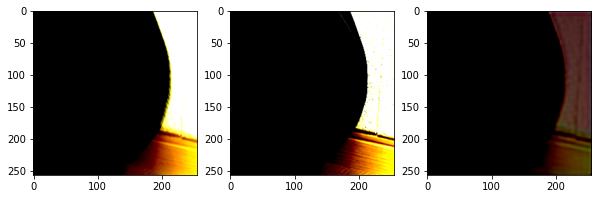

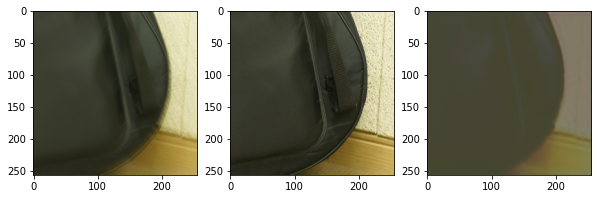

---- -2.811304e-08 ,, 1.0
=====
This is epoch 12
And the PSNR is 20.64867826621417
And the images are...


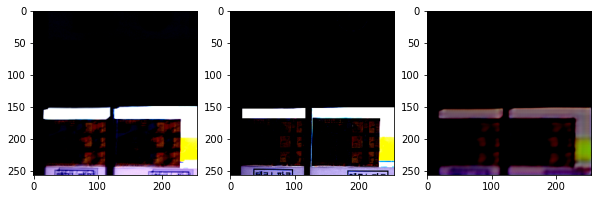

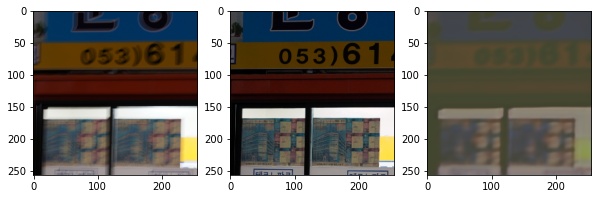

---- 0.0 ,, 1.0
=====
This is epoch 13
And the PSNR is 16.763509690580257
And the images are...


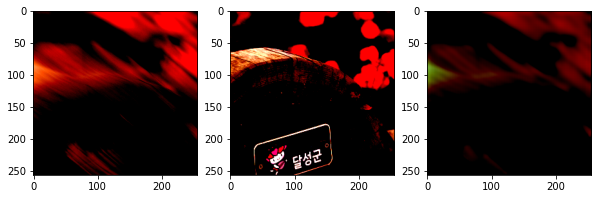

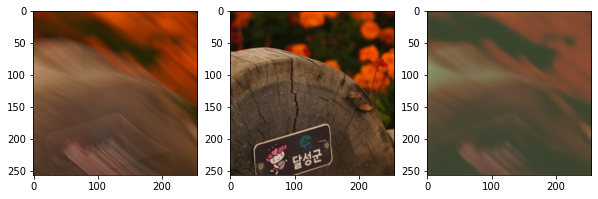

---- 0.011764705 ,, 1.0
=====
This is epoch 14
And the PSNR is 14.293556024910025
And the images are...


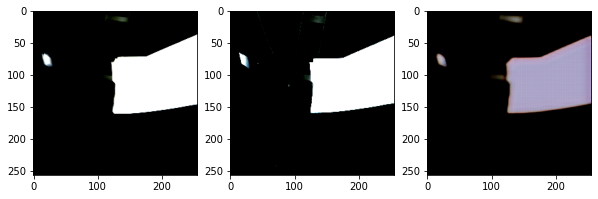

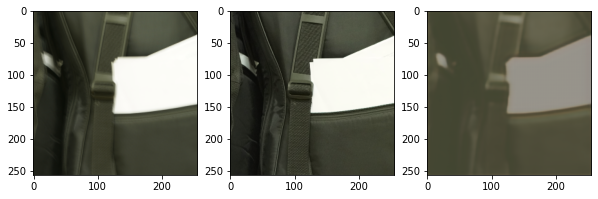

---- -2.811304e-08 ,, 0.89803916
=====
This is epoch 15
And the PSNR is 23.731764513819424
And the images are...


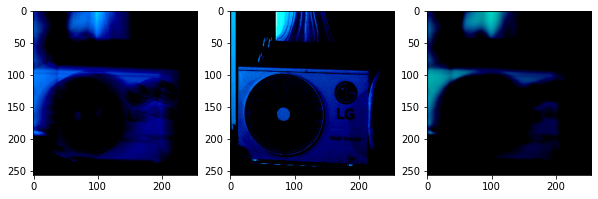

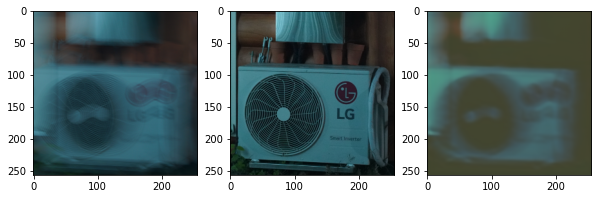

---- -2.811304e-08 ,, 1.0
=====
This is epoch 16
And the PSNR is 25.840289693623347
And the images are...


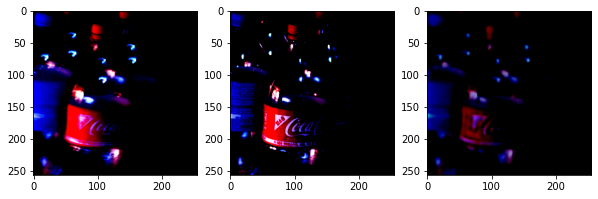

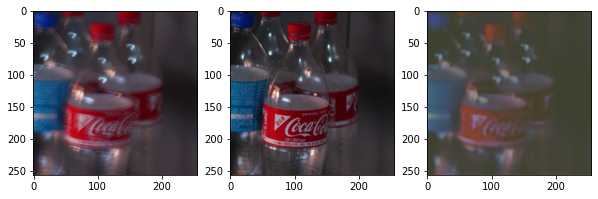

---- -2.811304e-08 ,, 1.0
=====
This is epoch 17
And the PSNR is 21.89000657446691
And the images are...


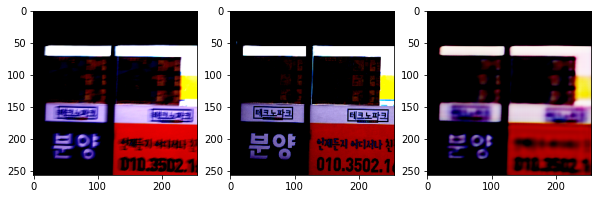

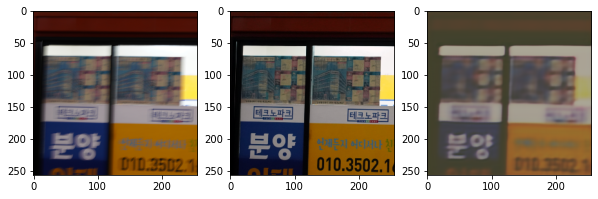

---- 0.0078431275 ,, 0.890196
=====
This is epoch 18
And the PSNR is 21.502941307280544
And the images are...


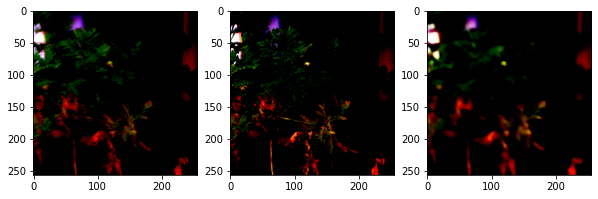

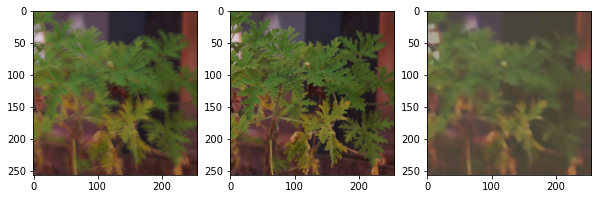

---- -2.6311284e-08 ,, 0.82745093
=====
This is epoch 19
And the PSNR is 25.433912562877538
And the images are...


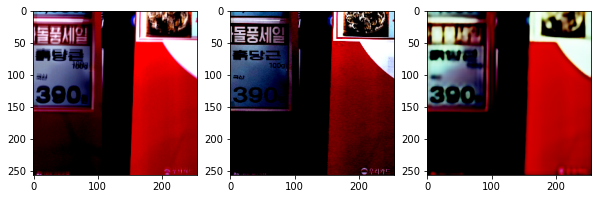

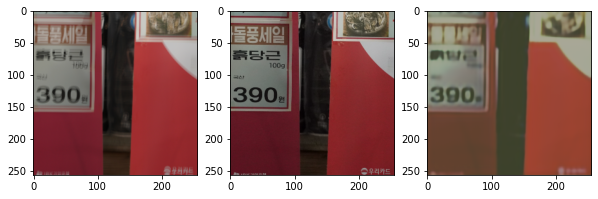

---- 0.011764689 ,, 0.8862744
=====
This is epoch 20
And the PSNR is 17.522647579781946
And the images are...


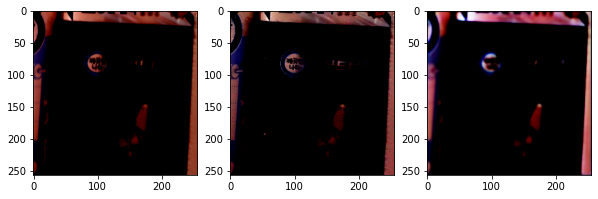

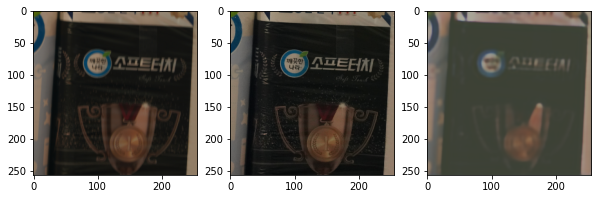

---- -2.811304e-08 ,, 0.78431374
=====
This is epoch 21
And the PSNR is 27.82703071969568
And the images are...


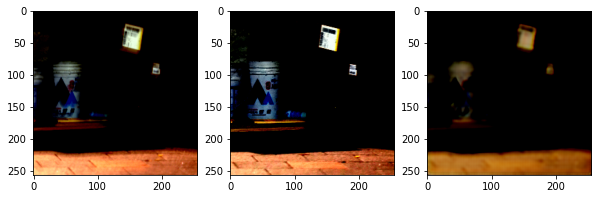

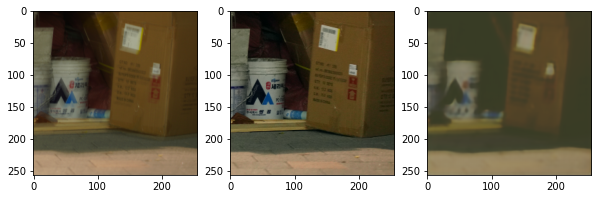

---- -2.6311284e-08 ,, 0.98823524
=====
This is epoch 22
And the PSNR is 24.34159916856968
And the images are...


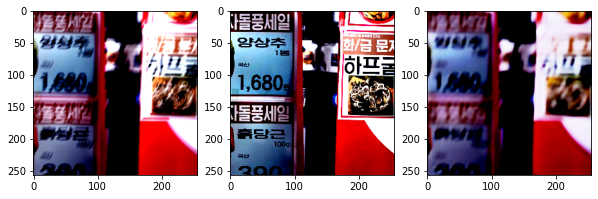

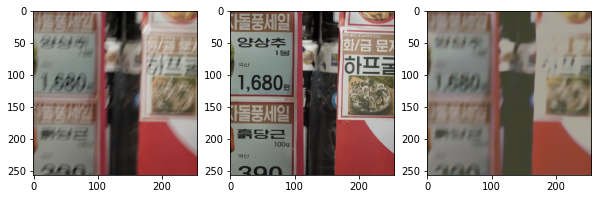

---- 0.011764689 ,, 0.98823524
=====
This is epoch 23
And the PSNR is 21.851266944112822
And the images are...


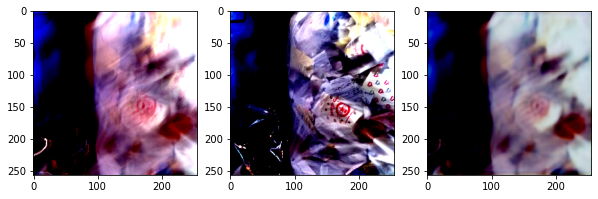

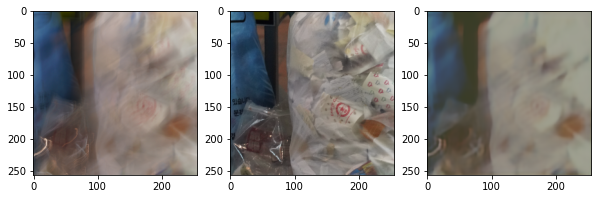

---- 0.003921565 ,, 0.9647058
=====
This is epoch 24
And the PSNR is 13.69523633092806
And the images are...


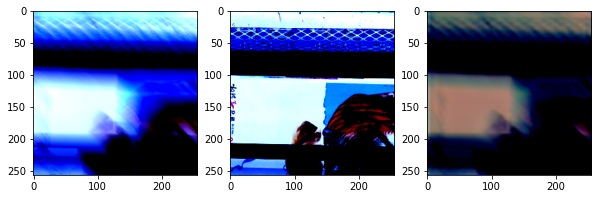

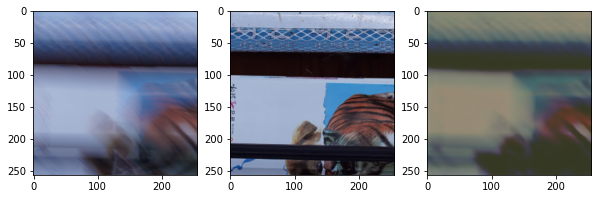

---- 0.003921565 ,, 0.9647058
=====
This is epoch 25
And the PSNR is 15.400779619263806
And the images are...


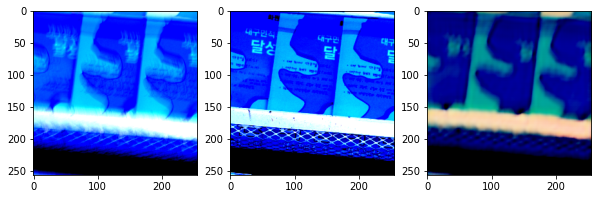

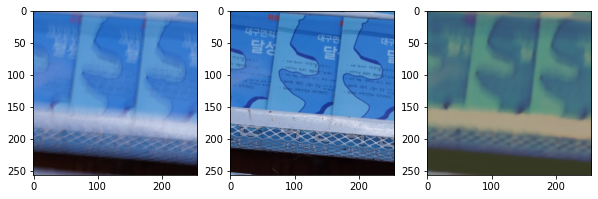

---- 0.0 ,, 1.0
=====
This is epoch 26
And the PSNR is 19.530833721609415
And the images are...


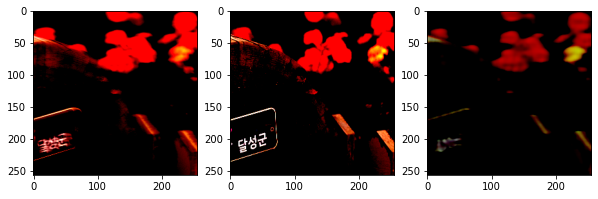

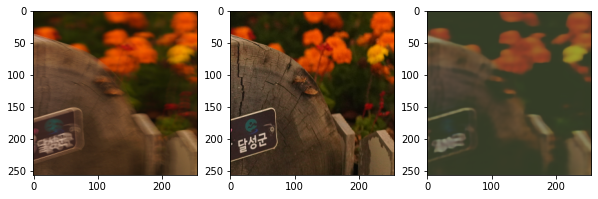

---- -2.811304e-08 ,, 0.97254896
=====
This is epoch 27
And the PSNR is 23.18567785162285
And the images are...


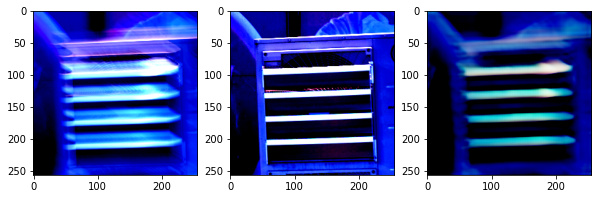

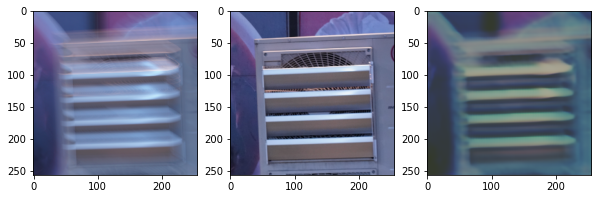

---- -2.811304e-08 ,, 1.0
=====
This is epoch 28
And the PSNR is 25.071769689358252
And the images are...


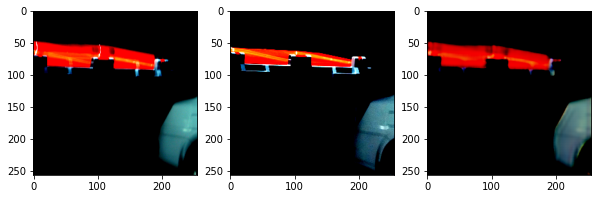

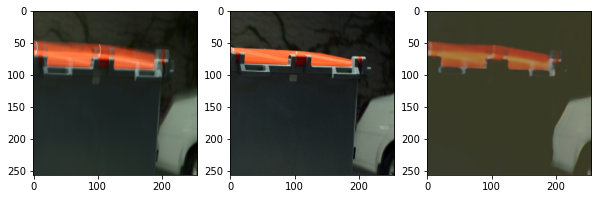

---- -2.811304e-08 ,, 1.0
=====
This is epoch 29
And the PSNR is 22.96793472083964
And the images are...


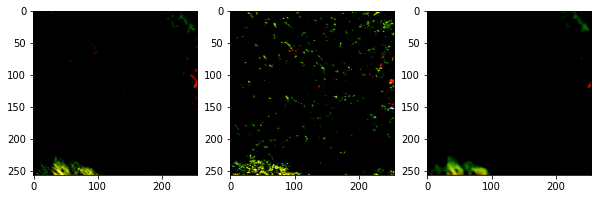

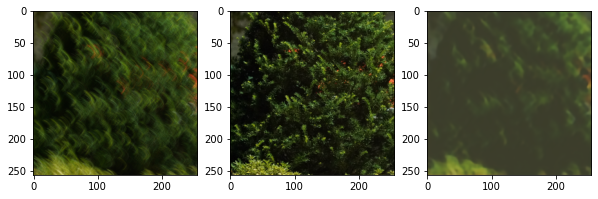

---- 0.003921544 ,, 0.7686274
=====
This is epoch 30
And the PSNR is 25.611923004408915
And the images are...


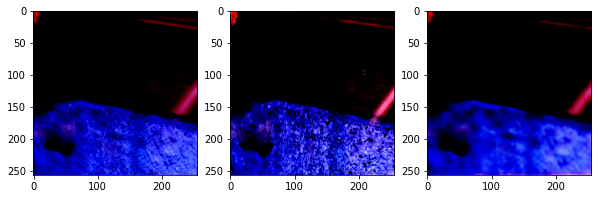

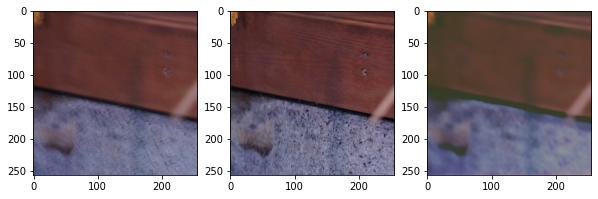

---- -2.811304e-08 ,, 0.84313726
=====
This is epoch 31
And the PSNR is 23.54076752211673
And the images are...


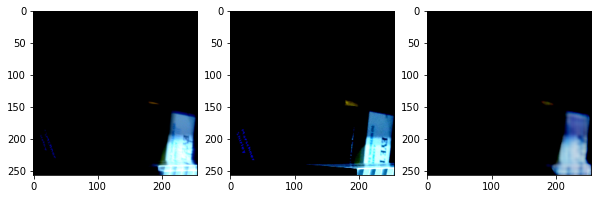

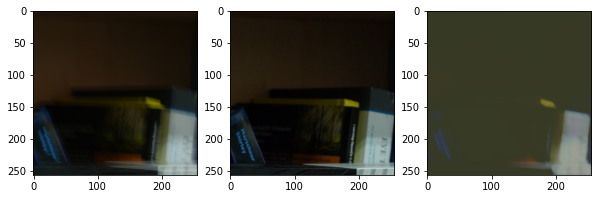

---- 0.0 ,, 1.0
=====
This is epoch 32
And the PSNR is 20.165877993804365
And the images are...


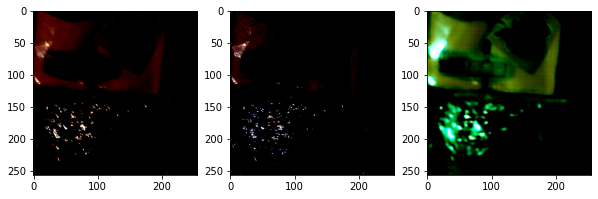

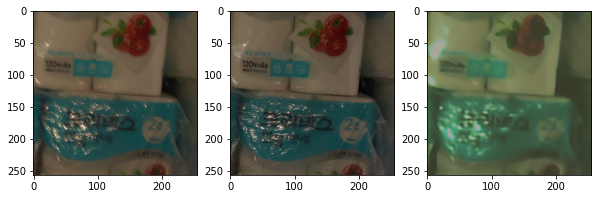

---- 0.04705882 ,, 0.98823524
=====
This is epoch 33
And the PSNR is 16.822337385955453
And the images are...


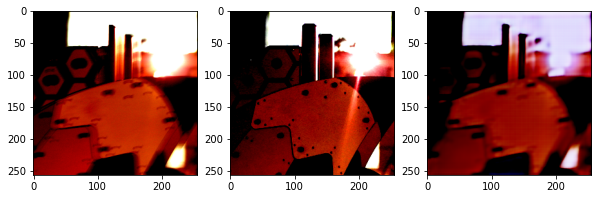

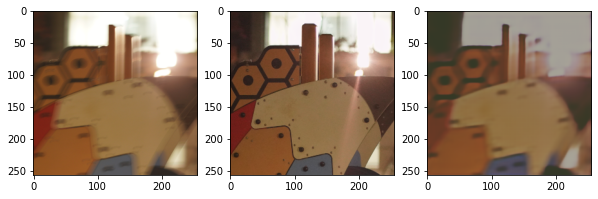

---- 0.11372547 ,, 0.8156863
=====
This is epoch 34
And the PSNR is 20.61559369235951
And the images are...


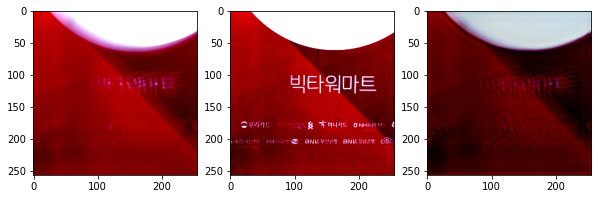

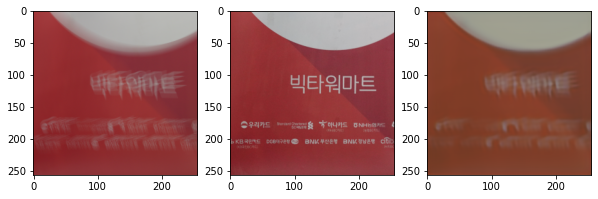

---- -2.811304e-08 ,, 1.0
=====
This is epoch 35
And the PSNR is 29.092644528218443
And the images are...


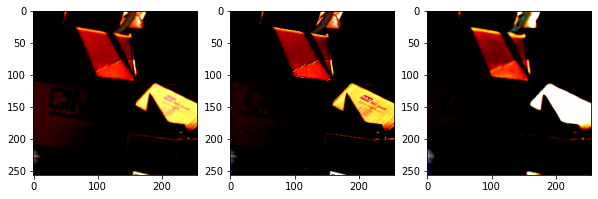

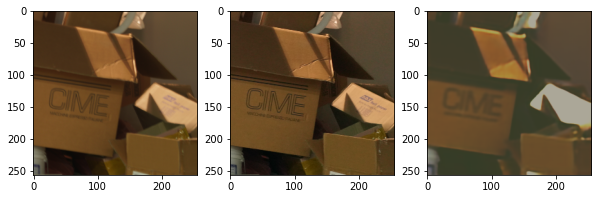

---- -2.811304e-08 ,, 1.0
=====
This is epoch 36
And the PSNR is 26.284148323968775
And the images are...


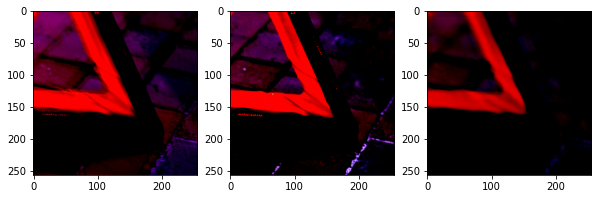

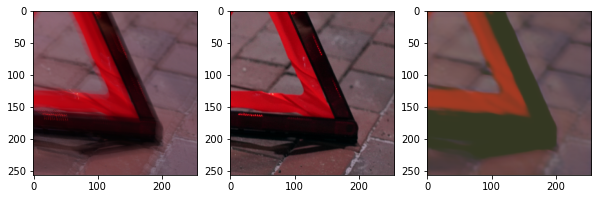

---- 0.0 ,, 0.4666666
=====
This is epoch 37
And the PSNR is 26.869983877557054
And the images are...


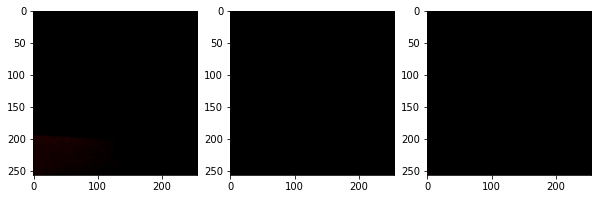

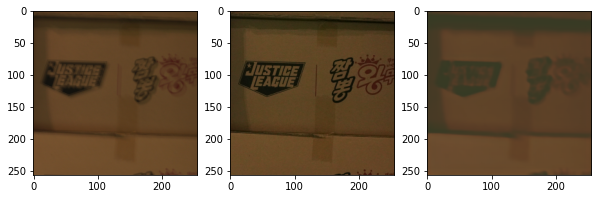

---- 0.003921565 ,, 0.9607842
=====
This is epoch 38
And the PSNR is 15.762119392336107
And the images are...


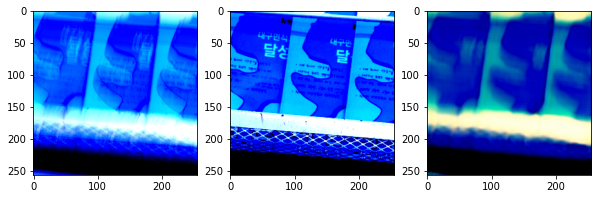

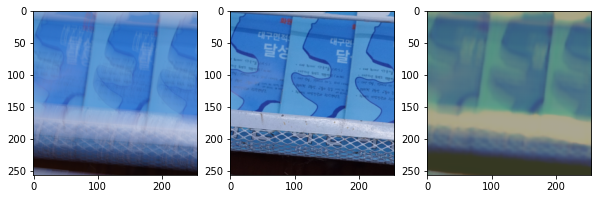

---- -2.811304e-08 ,, 0.85098034
=====
This is epoch 39
And the PSNR is 31.765899810185978
And the images are...


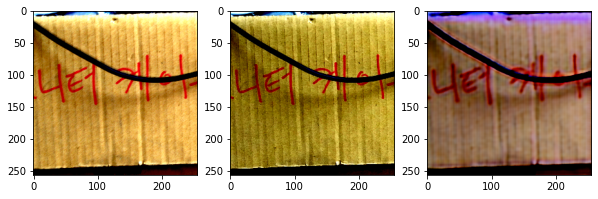

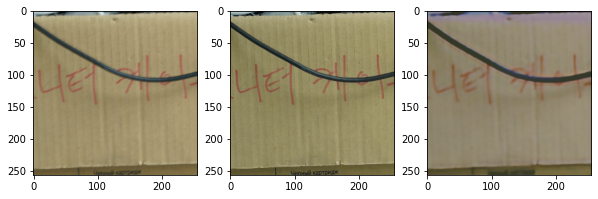

---- 0.003921544 ,, 0.9960784
=====
This is epoch 40
And the PSNR is 18.849924227107138
And the images are...


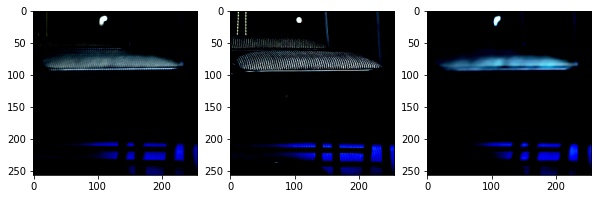

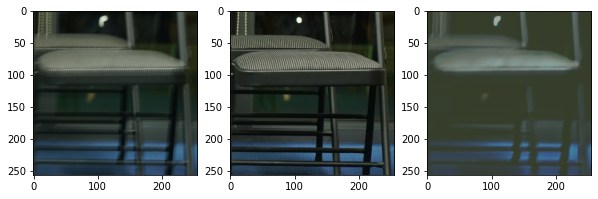

---- 0.00784313 ,, 0.8705882
=====
This is epoch 41
And the PSNR is 17.66375429218136
And the images are...


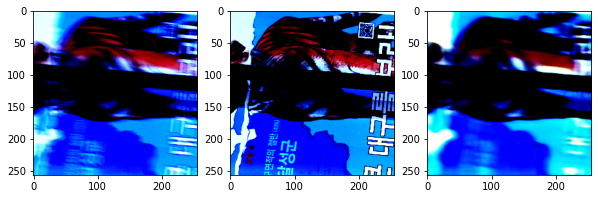

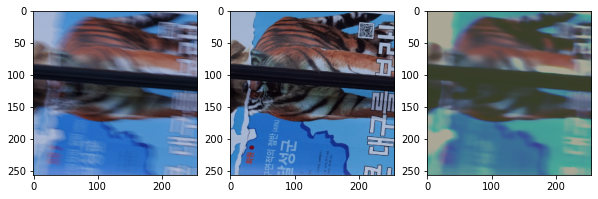

---- -2.811304e-08 ,, 0.99215686
=====
This is epoch 42
And the PSNR is 23.528970597508852
And the images are...


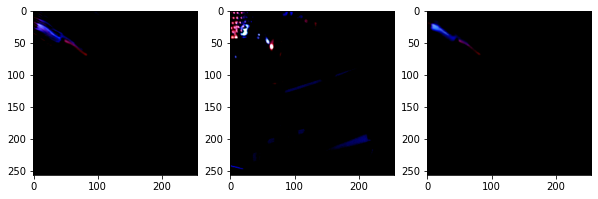

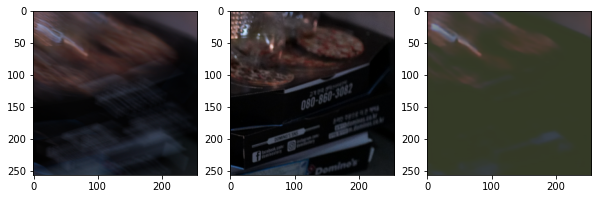

---- -2.811304e-08 ,, 0.9843136
=====
This is epoch 43
And the PSNR is 21.95862896418728
And the images are...


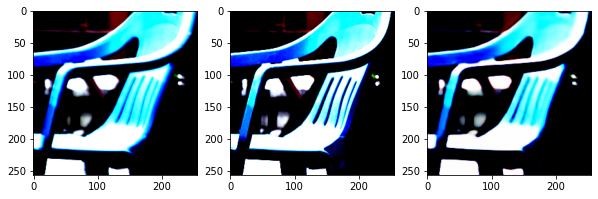

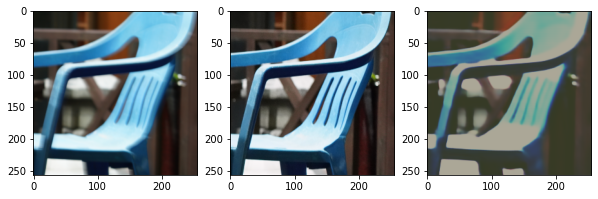

---- -2.811304e-08 ,, 0.97254914
=====
This is epoch 44
And the PSNR is 29.051619166947148
And the images are...


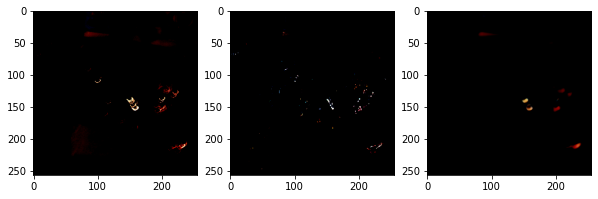

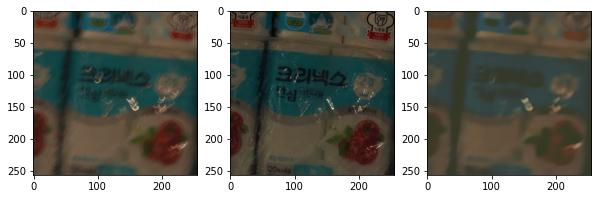

---- 0.015686255 ,, 0.8549019
=====
This is epoch 45
And the PSNR is 21.744721226856072
And the images are...


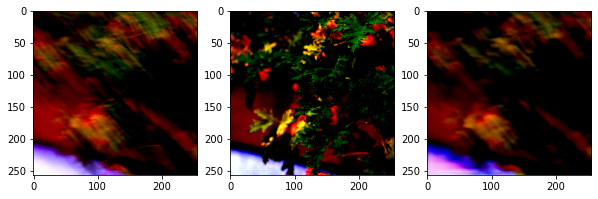

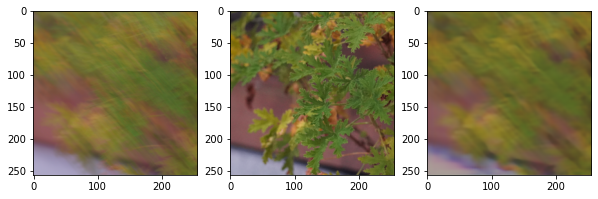

---- -2.811304e-08 ,, 0.7921568
=====
This is epoch 46
And the PSNR is 24.210371730753394
And the images are...


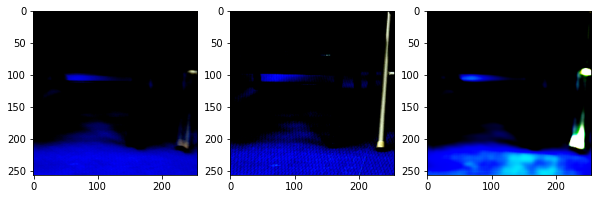

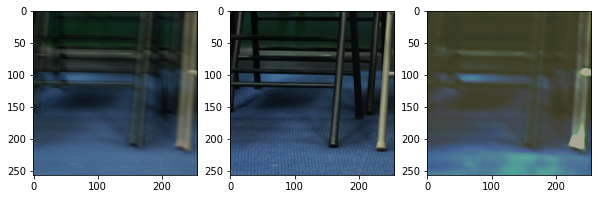

---- 0.0078431275 ,, 0.92549014
=====
This is epoch 47
And the PSNR is 23.549850424407026
And the images are...


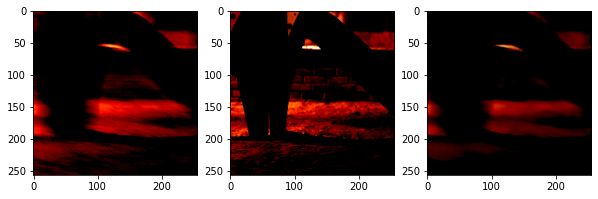

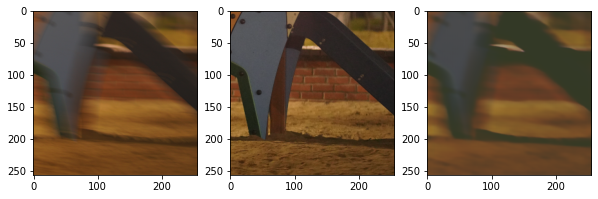

---- 0.0 ,, 0.9960784
=====
This is epoch 48
And the PSNR is 22.524109564218058
And the images are...


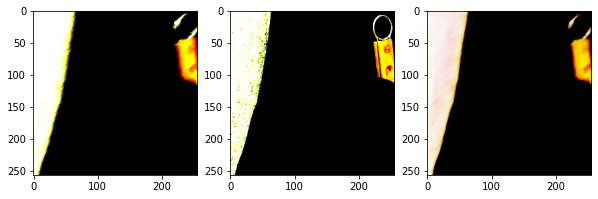

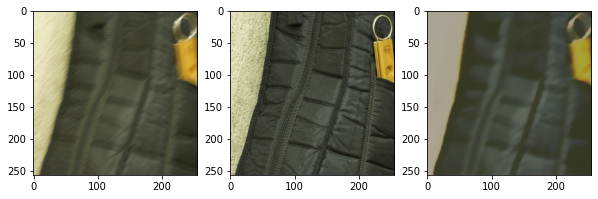

---- 0.0 ,, 0.89803916
=====
This is epoch 49
And the PSNR is 24.419503213974508
And the images are...


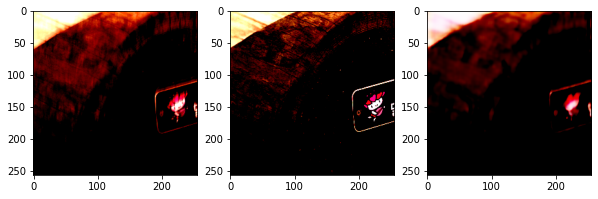

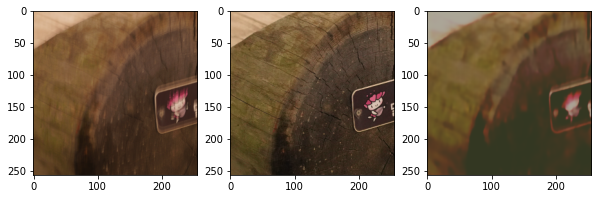

---- 0.0039215502 ,, 0.98823524
=====
This is epoch 50
And the PSNR is 20.12511279649071
And the images are...


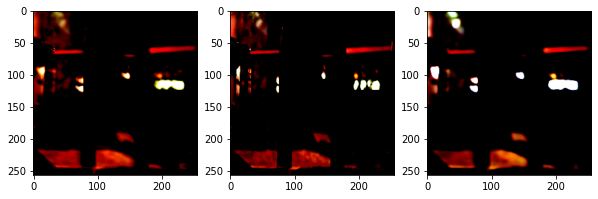

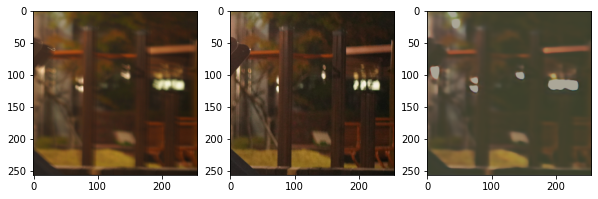

---- 0.007843117 ,, 0.97254896
=====
This is epoch 51
And the PSNR is 20.32914776574799
And the images are...


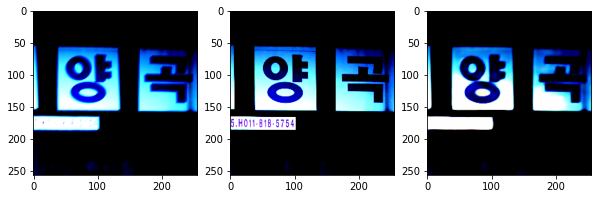

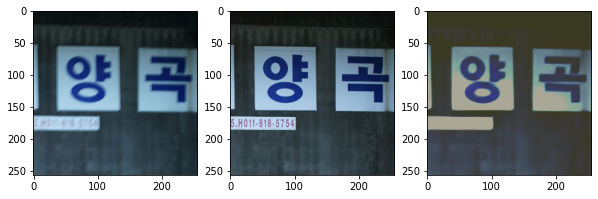

---- 0.011764705 ,, 1.0
=====
This is epoch 52
And the PSNR is 14.258546218117116
And the images are...


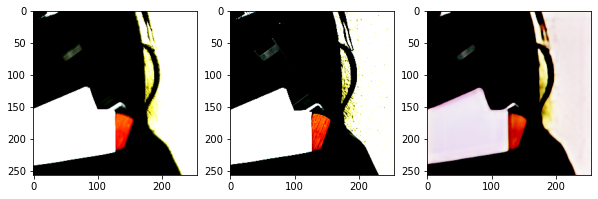

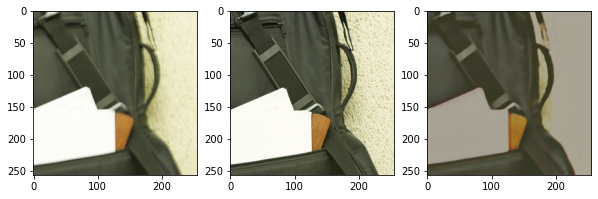

---- -2.811304e-08 ,, 1.0
=====
This is epoch 53
And the PSNR is 29.163225367230385
And the images are...


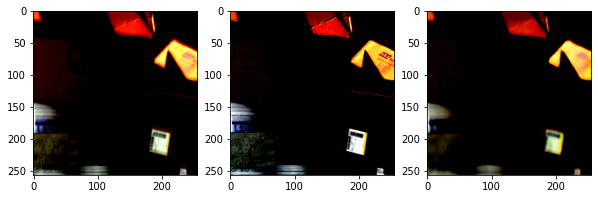

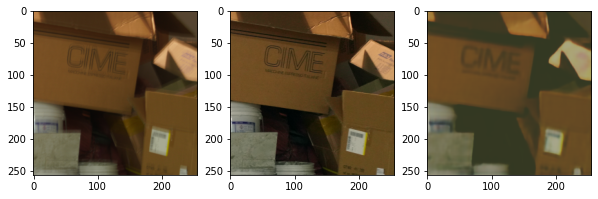

---- -2.811304e-08 ,, 0.8549019
=====
This is epoch 54
And the PSNR is 23.91351701314429
And the images are...


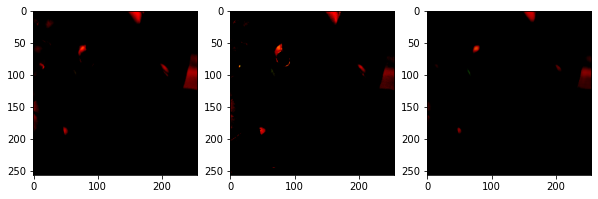

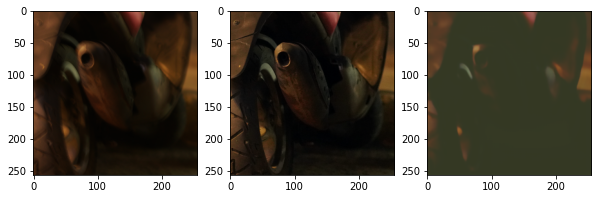

---- -2.811304e-08 ,, 0.98823524
=====
This is epoch 55
And the PSNR is 23.87106230083819
And the images are...


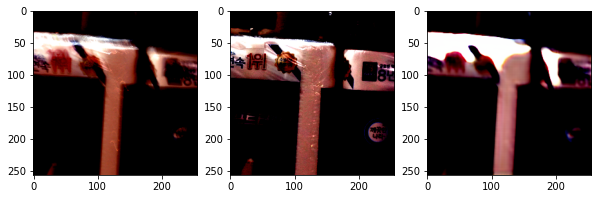

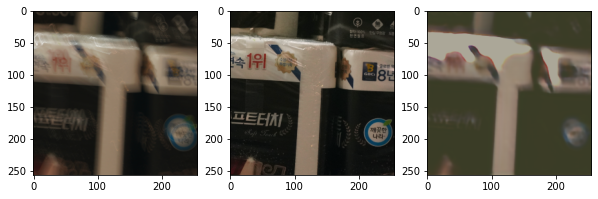

---- -2.811304e-08 ,, 1.0
=====
This is epoch 56
And the PSNR is 24.25026696840788
And the images are...


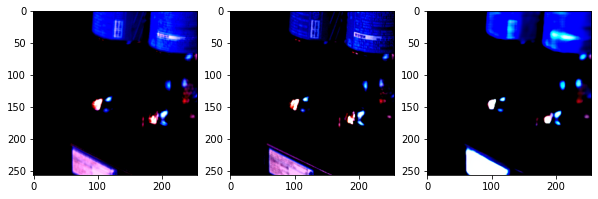

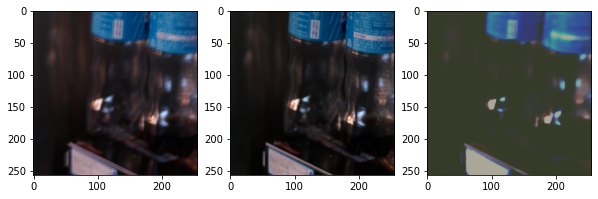

---- -2.811304e-08 ,, 0.9686274
=====
This is epoch 57
And the PSNR is 24.92647721923607
And the images are...


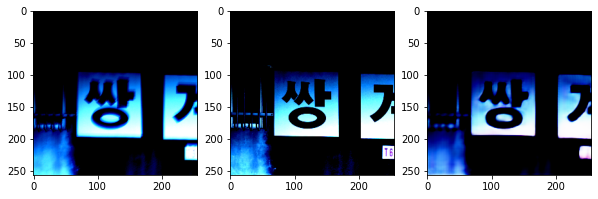

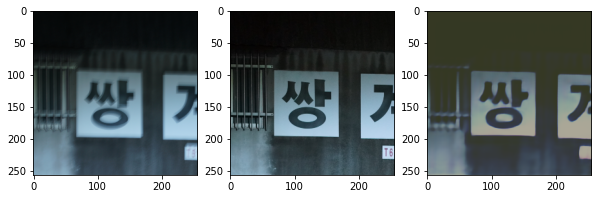

---- 0.0 ,, 0.9843136
=====
This is epoch 58
And the PSNR is 20.442365527169812
And the images are...


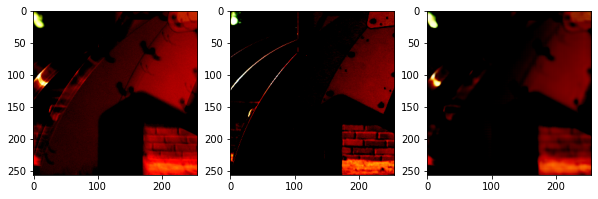

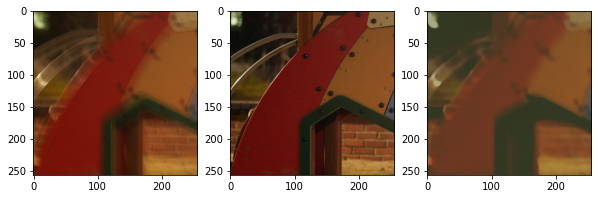

---- 0.015686255 ,, 1.0
=====
This is epoch 59
And the PSNR is 20.954069168443855
And the images are...


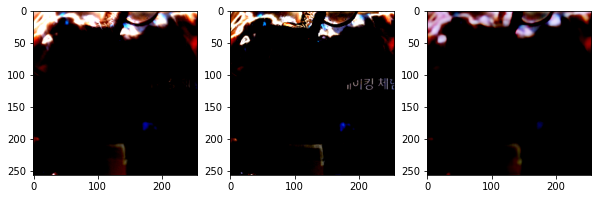

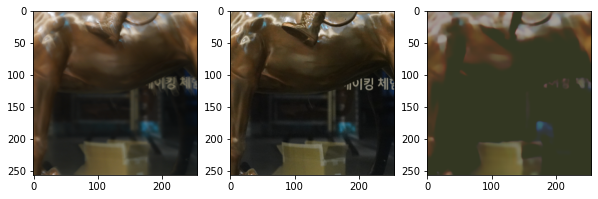

---- 0.02352941 ,, 0.9450979
=====
This is epoch 60
And the PSNR is 24.311728205362275
And the images are...


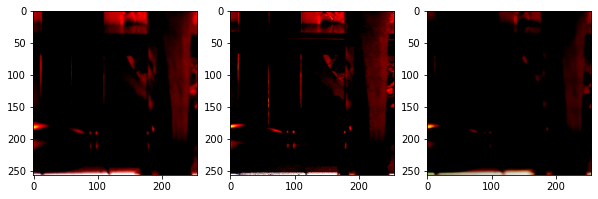

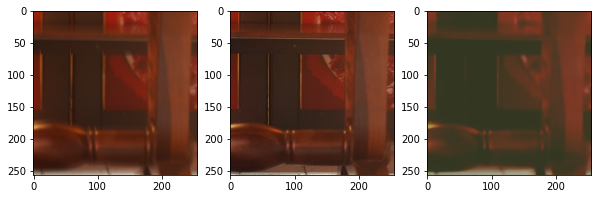

---- -2.6311284e-08 ,, 0.97254896
=====
This is epoch 61
And the PSNR is 24.794259723514674
And the images are...


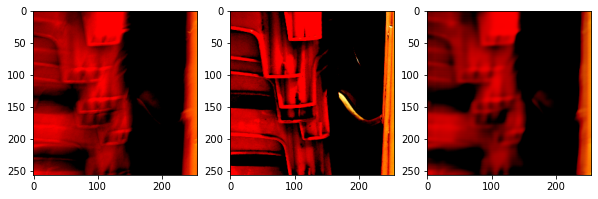

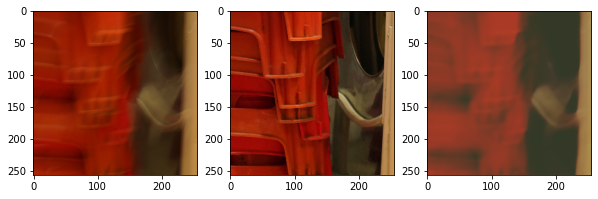

---- 0.0039215502 ,, 0.8470588
=====
This is epoch 62
And the PSNR is 22.864944036741246
And the images are...


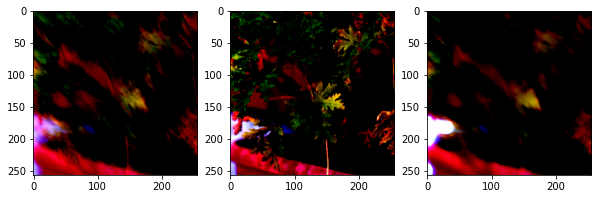

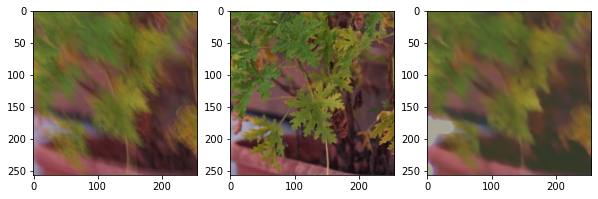

---- -2.811304e-08 ,, 0.9686274
=====
This is epoch 63
And the PSNR is 26.941061312746676
And the images are...


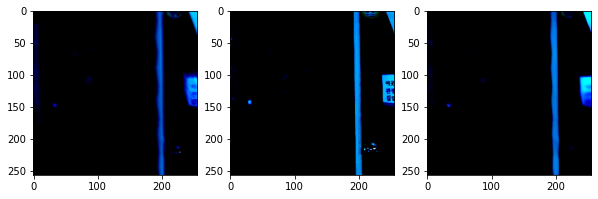

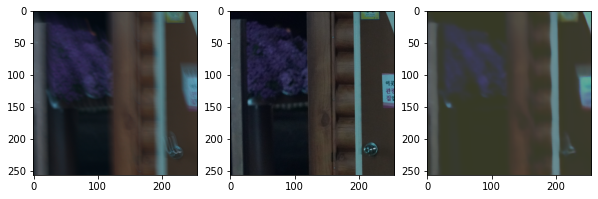

---- 0.019607833 ,, 0.9999999
=====
This is epoch 64
And the PSNR is 19.36511400957381
And the images are...


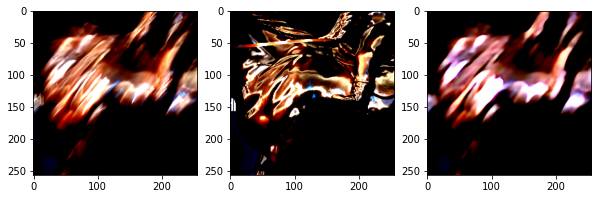

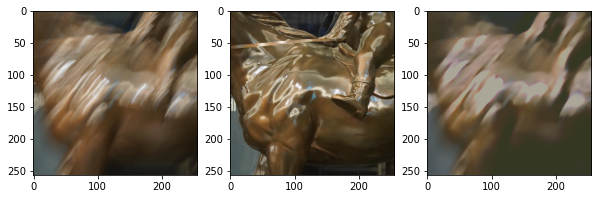

---- 0.0039215502 ,, 0.74509805
=====
This is epoch 65
And the PSNR is 26.96628256482218
And the images are...


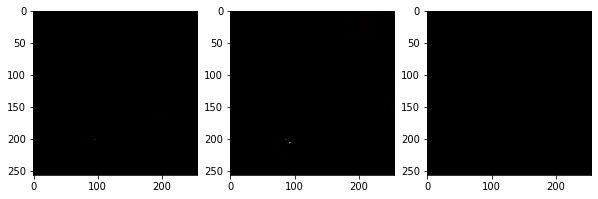

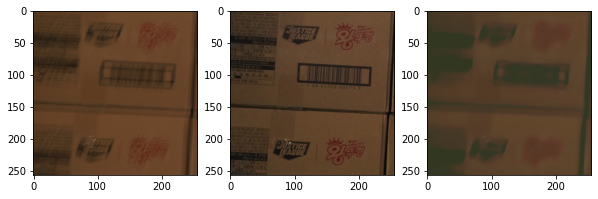

---- -2.811304e-08 ,, 0.9372547
=====
This is epoch 66
And the PSNR is 23.89764839618691
And the images are...


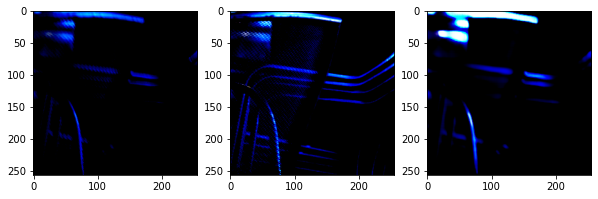

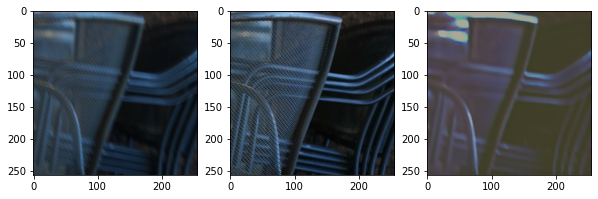

---- -2.811304e-08 ,, 1.0
=====
This is epoch 67
And the PSNR is 23.190156002579478
And the images are...


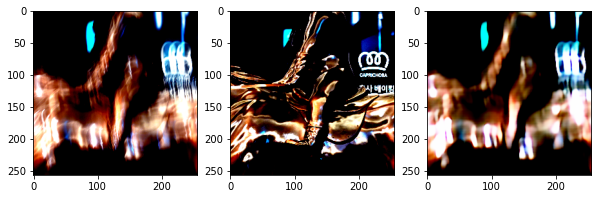

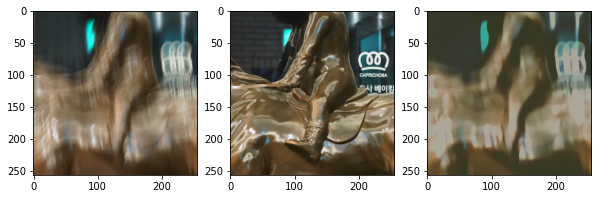

---- -2.811304e-08 ,, 1.0
=====
This is epoch 68
And the PSNR is 24.129834229606942
And the images are...


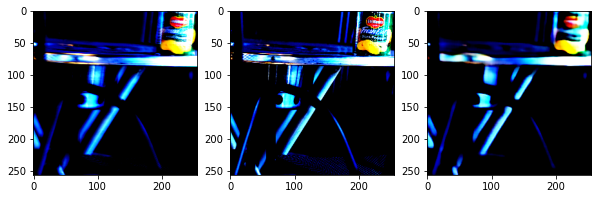

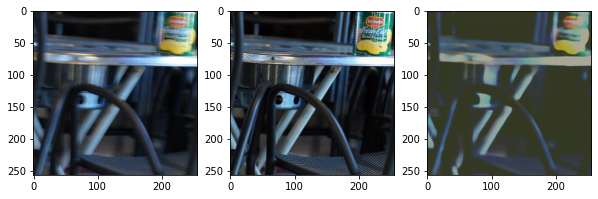

---- 0.04705882 ,, 0.8039215
=====
This is epoch 69
And the PSNR is 23.297719866032857
And the images are...


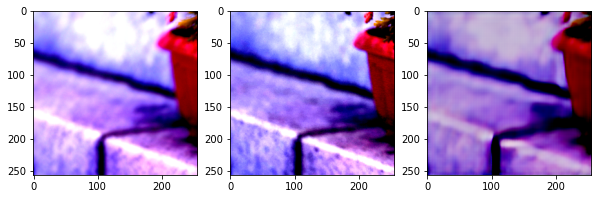

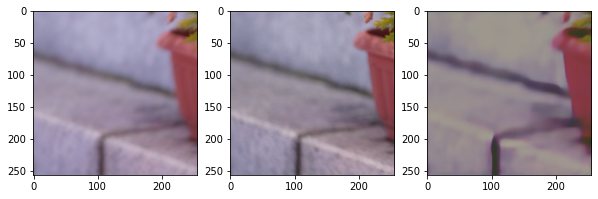

---- -2.811304e-08 ,, 1.0
=====
This is epoch 70
And the PSNR is 22.574290737249072
And the images are...


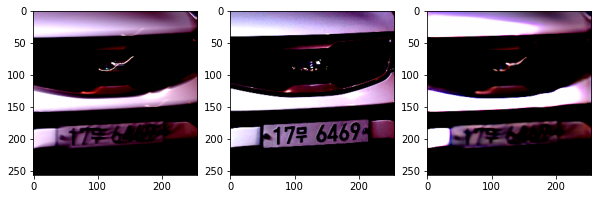

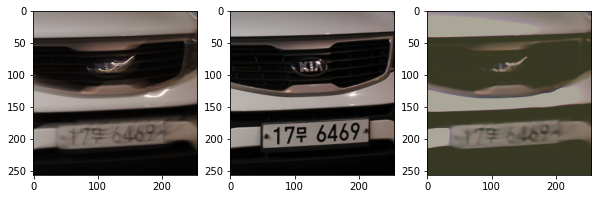

---- 0.003921565 ,, 0.9568626
=====
This is epoch 71
And the PSNR is 15.88380866874646
And the images are...


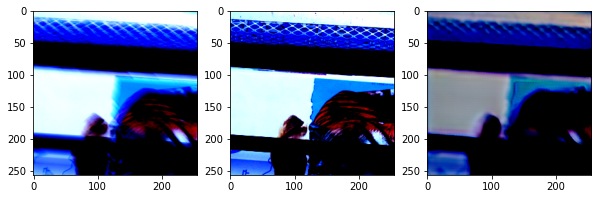

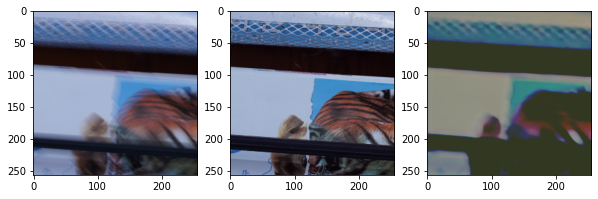

---- 0.011764689 ,, 0.98823524
=====
This is epoch 72
And the PSNR is 24.465686535251322
And the images are...


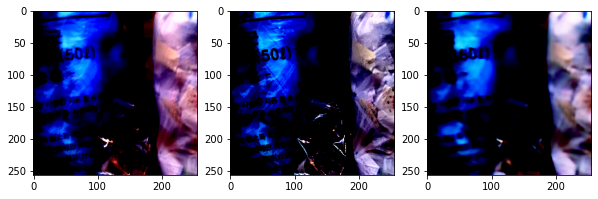

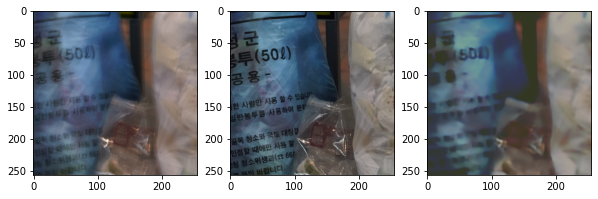

---- -2.811304e-08 ,, 0.9999999
=====
This is epoch 73
And the PSNR is 25.67096126489502
And the images are...


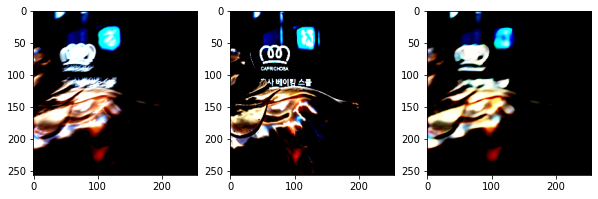

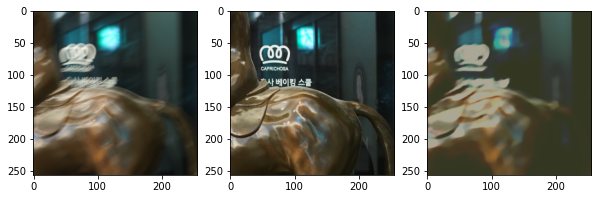

---- -2.811304e-08 ,, 1.0
=====
This is epoch 74
And the PSNR is 25.675576133928647
And the images are...


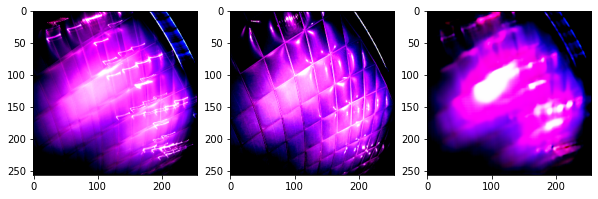

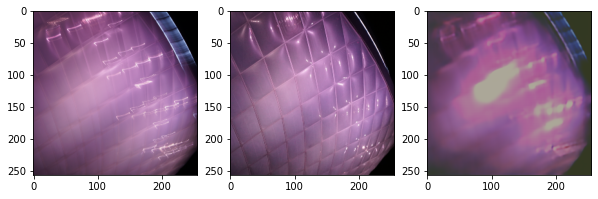

---- -2.811304e-08 ,, 0.8000001
=====
This is epoch 75
And the PSNR is 29.347955866698218
And the images are...


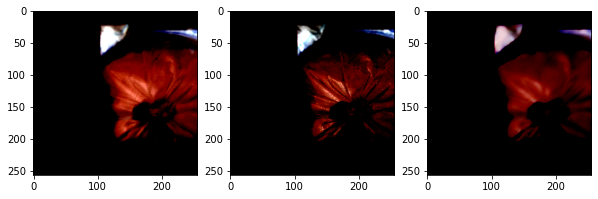

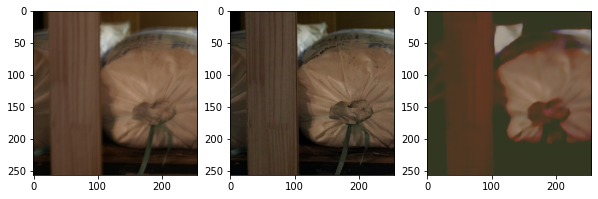

---- -2.811304e-08 ,, 0.97647053
=====
This is epoch 76
And the PSNR is 24.87219361404156
And the images are...


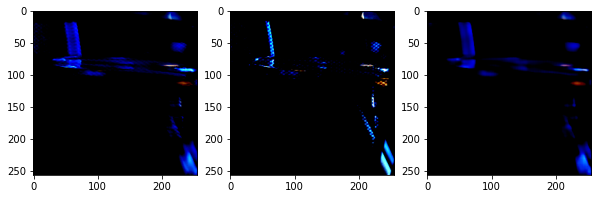

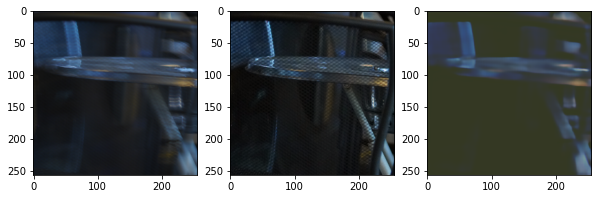

---- -2.811304e-08 ,, 0.02352941
=====
This is epoch 77
And the PSNR is 20.471126362445542
And the images are...


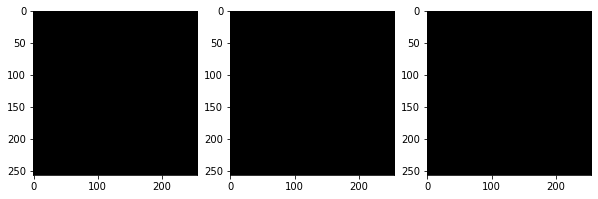

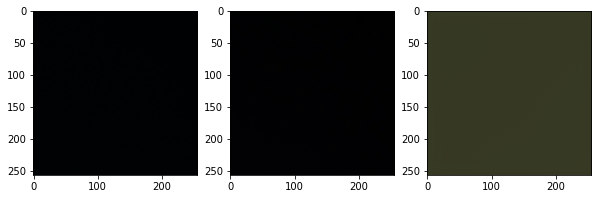

---- 0.015686255 ,, 0.74117655
=====
This is epoch 78
And the PSNR is 22.24154300827056
And the images are...


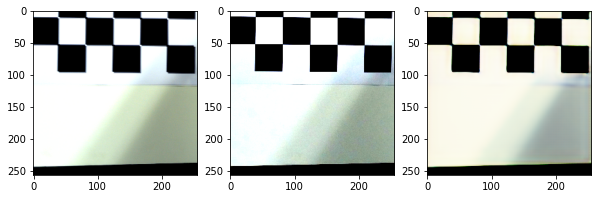

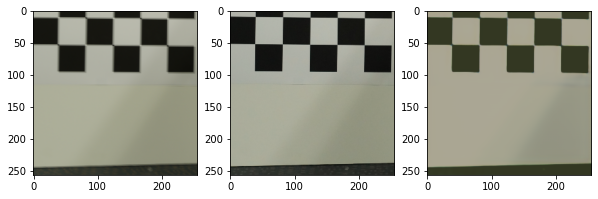

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 79
And the PSNR is 25.16038155558654
And the images are...


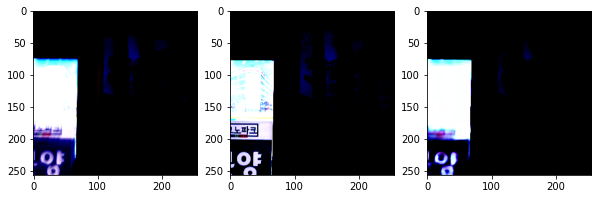

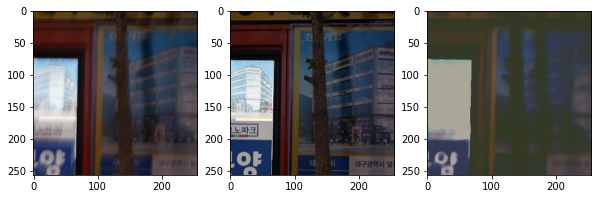

---- 0.011764689 ,, 0.9686274
=====
This is epoch 80
And the PSNR is 21.026568619557032
And the images are...


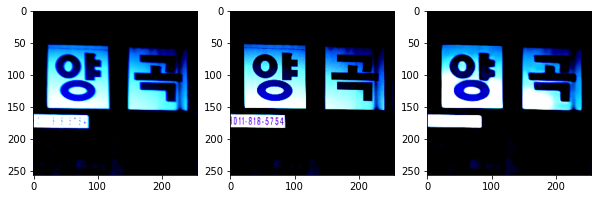

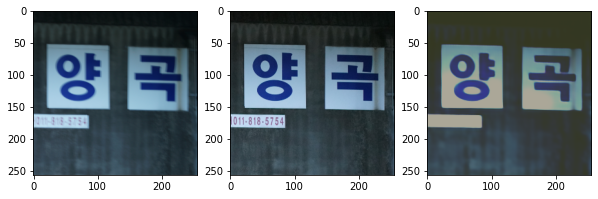

---- -2.811304e-08 ,, 0.882353
=====
This is epoch 81
And the PSNR is 28.536053725385546
And the images are...


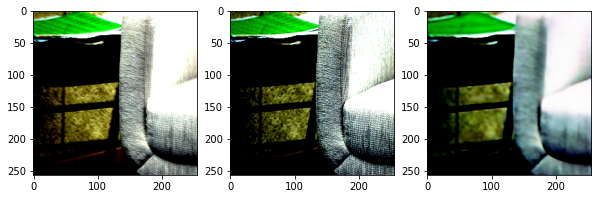

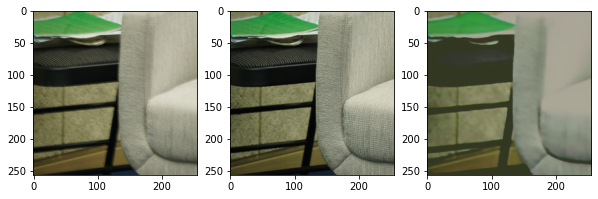

---- -2.811304e-08 ,, 0.85882354
=====
This is epoch 82
And the PSNR is 25.651390744256553
And the images are...


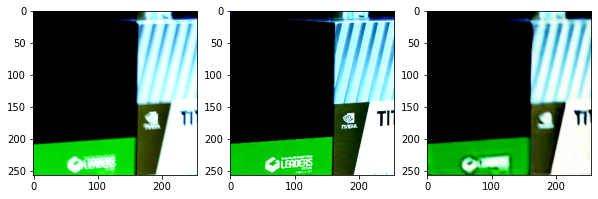

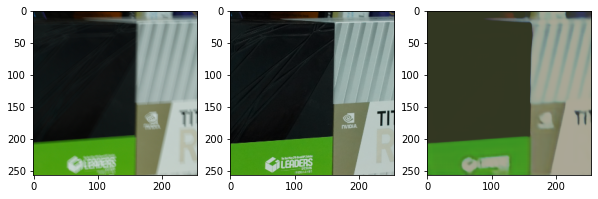

---- -2.811304e-08 ,, 0.91372544
=====
This is epoch 83
And the PSNR is 24.653067113089865
And the images are...


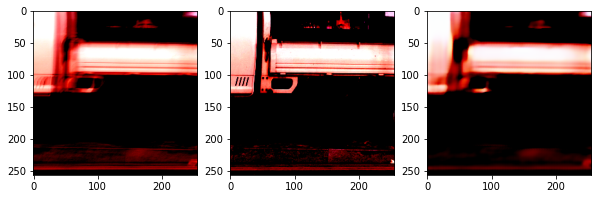

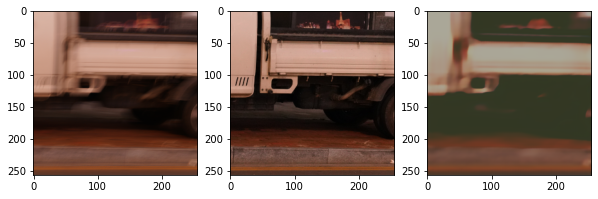

---- 0.011764705 ,, 0.9960784
=====
This is epoch 84
And the PSNR is 17.73776239249791
And the images are...


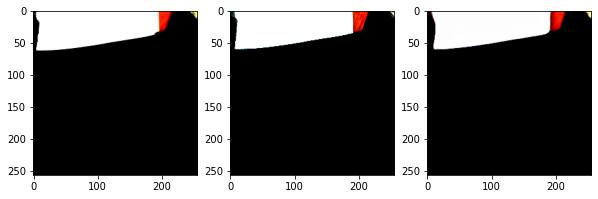

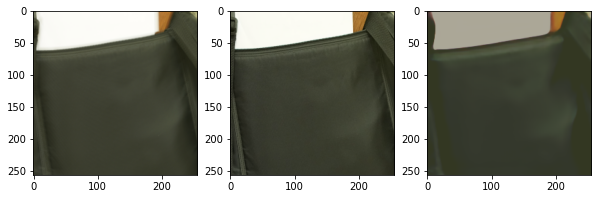

---- 0.0 ,, 1.0
=====
This is epoch 85
And the PSNR is 14.7133214266262
And the images are...


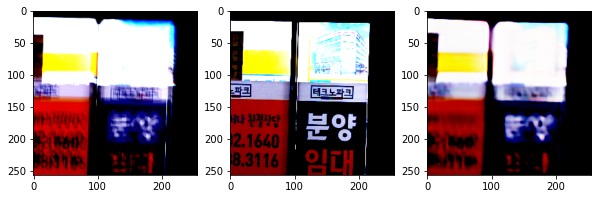

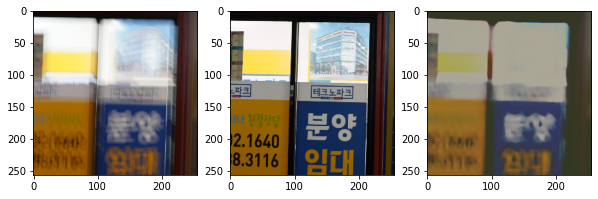

---- -2.811304e-08 ,, 0.84705883
=====
This is epoch 86
And the PSNR is 23.39508348191371
And the images are...


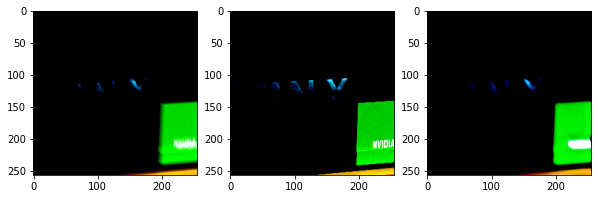

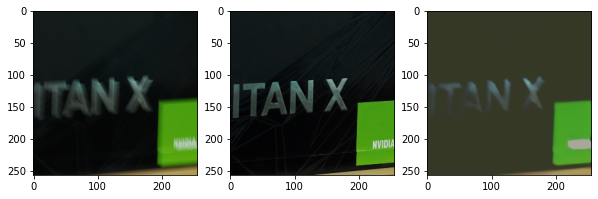

---- 0.003921544 ,, 0.7411764
=====
This is epoch 87
And the PSNR is 23.446673266294894
And the images are...


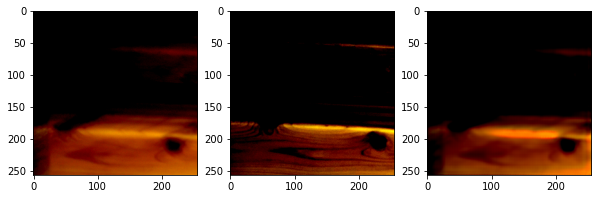

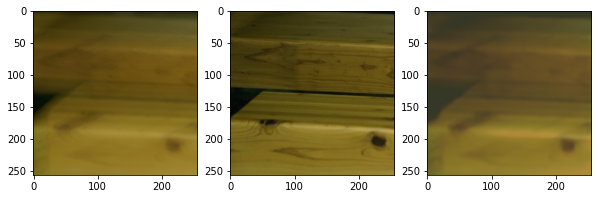

---- -2.6311284e-08 ,, 0.98823524
=====
This is epoch 88
And the PSNR is 29.216109152437095
And the images are...


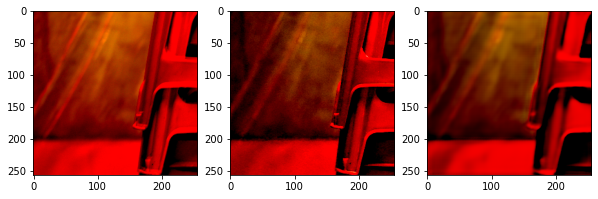

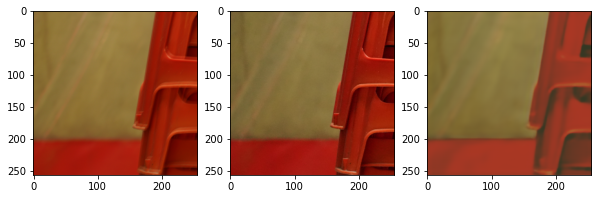

---- -2.811304e-08 ,, 1.0
=====
This is epoch 89
And the PSNR is 30.14728675238381
And the images are...


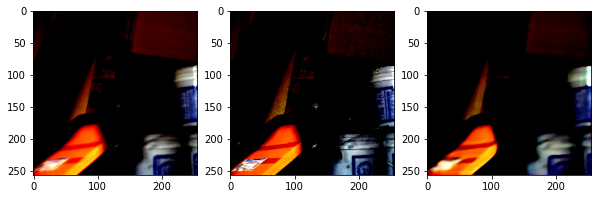

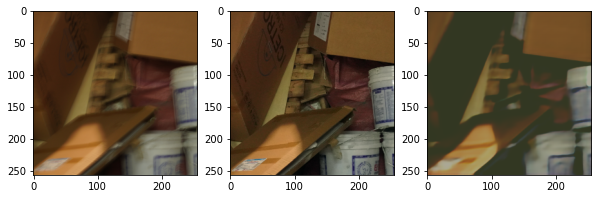

---- -2.811304e-08 ,, 1.0
=====
This is epoch 90
And the PSNR is 25.997828451722448
And the images are...


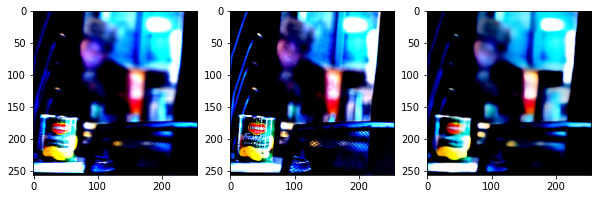

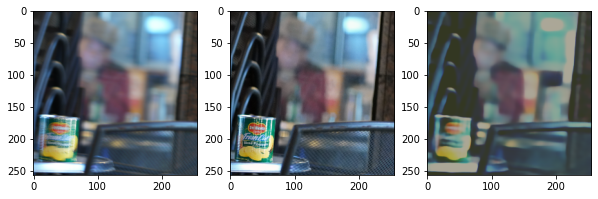

---- 0.0078431275 ,, 0.8745098
=====
This is epoch 91
And the PSNR is 25.00248125700005
And the images are...


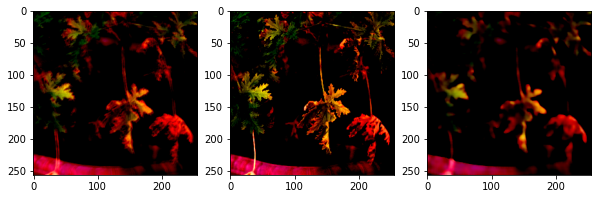

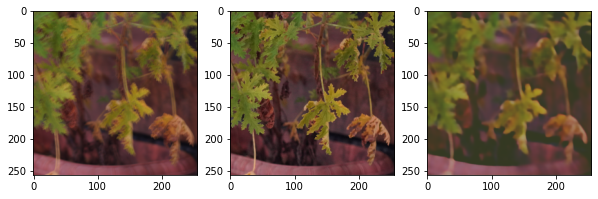

---- 0.003921544 ,, 0.5215686
=====
This is epoch 92
And the PSNR is 24.48941670485582
And the images are...


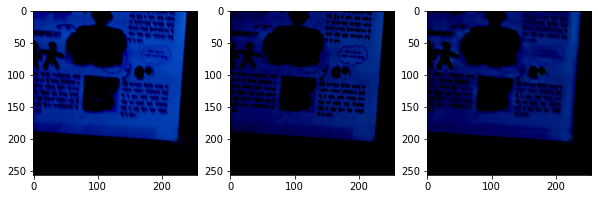

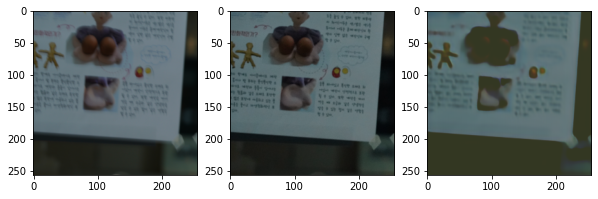

---- 0.0078431275 ,, 0.82352936
=====
This is epoch 93
And the PSNR is 22.240236995296883
And the images are...


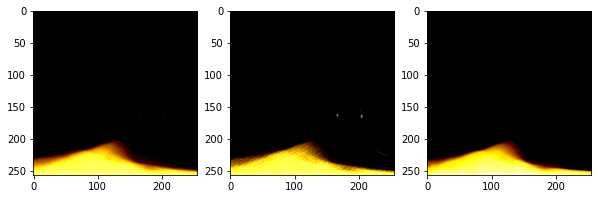

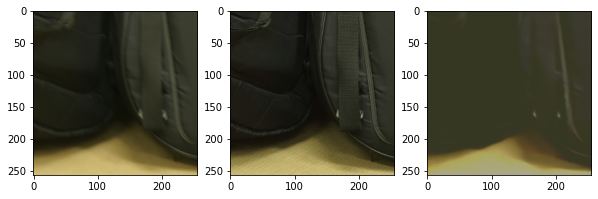

---- -2.811304e-08 ,, 0.9960784
=====
This is epoch 94
And the PSNR is 21.864825018670253
And the images are...


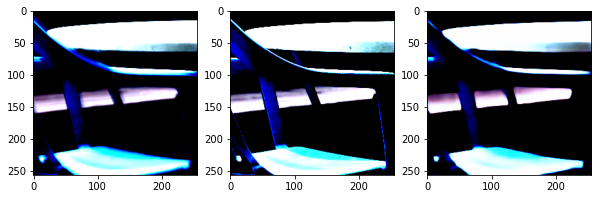

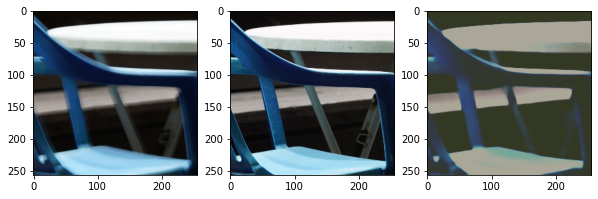

---- 0.0078431275 ,, 1.0
=====
This is epoch 95
And the PSNR is 19.411805373265377
And the images are...


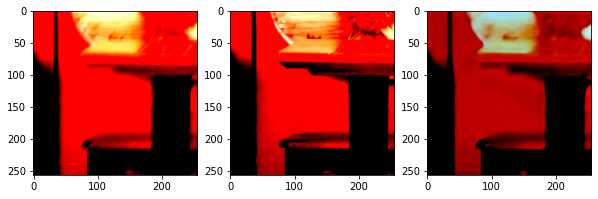

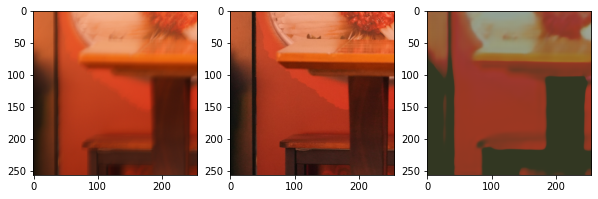

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 96
And the PSNR is 26.320892652048506
And the images are...


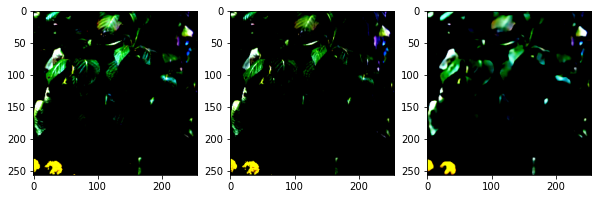

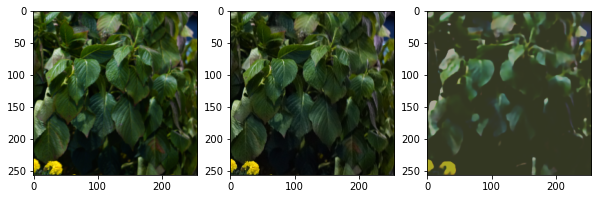

---- 0.015686255 ,, 0.82352936
=====
This is epoch 97
And the PSNR is 27.195726877184644
And the images are...


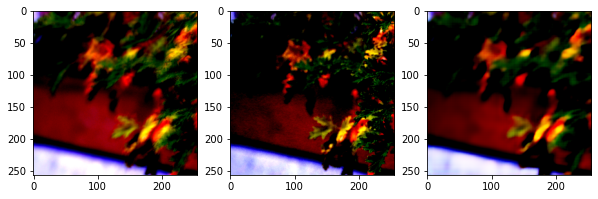

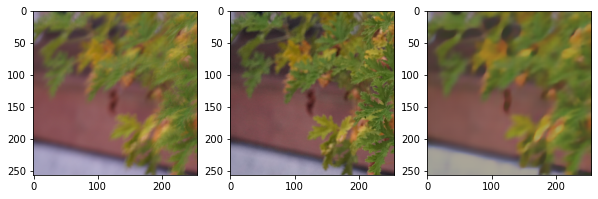

In [ ]:
# dataset = BSD_B_Dataset(path, target_size=target_size)
# dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
datamodule = BSD_B_DataModule(batch_size=batch_size, target_size=target_size, mean=mean, std=std)

pix2pix = Pix2Pix(3, 3, learning_rate=lr, lambda_recon=lambda_recon, display_step=display_step, mean=mean, std=std)
trainer = pl.Trainer(max_epochs=n_epochs, gpus=1, callbacks=[checkpoint_callback])   # REMEMBER THE GPU
# trainer.fit(pix2pix, dataloader)
trainer.fit(pix2pix, datamodule)